# SPI Paper Figures

Code used to generate paper figure, each heading level subsection can be run on its own with tweaks to the switches and global variables listed below

In [18]:
import glob as glob
import xarray as xr
import pandas as pd
import geopandas as gpd
import sys
sys.path.append('/g/data/mn51/users/jb6465/code/drought-github/submodules/plotting_maps')
from acs_area_statistics import *
from acs_plotting_maps import *

BC_SWITCH = True
BC_SOURCE = 'AGCDv1' #AGCDv1 BARRAR2
SSP = 'ssp370' #ssp370 ssp126

In [19]:
# NRM cluster regions
gdf = gpd.read_file(("/g/data/ia39/aus-ref-clim-data-nci/shapefiles/data/nrm_regions/nrm_regions.shp"))
nrm_regions = gdf.dissolve(by="ClusterAb").reset_index()

In [20]:
nrm_regions

,ClusterAb,geometry,SubClusNm,SubClusAb,ClusterNm,SupClusNm,SupClusAb
0,CS,"POLYGON ((147.957 -24.87855, 147.95711 -24.878...",Central Slopes,CS,Central Slopes,Eastern Australia,EA
1,EC,"MULTIPOLYGON (((153.53442 -28.17702, 153.53471...",East Coast (South),ECS,East Coast,Eastern Australia,EA
2,MB,"POLYGON ((145.74765 -32.21733, 145.75054 -32.2...",Murray Basin,MB,Murray Basin,Southern Australia,SA
3,MN,"POLYGON ((146.29742 -18.90381, 146.29992 -18.9...",Monsoonal North (East),MNE,Monsoonal North,Northern Australia,NA
4,R,"POLYGON ((114.14357 -22.538, 114.14296 -22.538...",Rangelands (North),RN,Rangelands,Rangelands,R
5,SS,"MULTIPOLYGON (((147.0437 -43.31381, 147.04111 ...",Southern Slopes (Vic/NSW East),SSVE,Southern Slopes,Southern Australia,SA
6,SSWF,"MULTIPOLYGON (((139.35429 -33.09761, 139.35429...",Southern and South Western Flatlands (West),SSWFW,Southern and South Western Flatlands,Southern Australia,SA
7,WT,"MULTIPOLYGON (((148.46219 -20.06725, 148.46352...",Wet Tropics,WT,Wet Tropics,Northern Australia,NA


## Study area fig

In [51]:
cd /g/data/mn51/users/jb6465/code/drought-github/submodules/plotting_maps

/g/data/mn51/users/jb6465/code/drought-github/submodules/plotting_maps


In [52]:
from acs_area_statistics import *
from acs_plotting_maps import *
import glob
import logging
(logging.getLogger('flox')).setLevel(logging.WARNING)

In [6]:
agcd_pr_dir = '/g/data/zv2/agcd/v1-0-2/precip/total/r005/01month'
agcd_tasmax_dir = '/g/data/zv2/agcd/v1-0-2/tmax/mean/r005/01month'
agcd_tasmin_dir = '/g/data/zv2/agcd/v1-0-2/tmin/mean/r005/01month'

In [7]:
agcd_pr_cube = xr.open_mfdataset(sorted([agcd_file for agcd_file in glob.glob(f"{agcd_pr_dir}/*.nc") if any(str(year) in agcd_file for year in range(1965, 2015))]))
agcd_tasmax_cube = xr.open_mfdataset(sorted([agcd_file for agcd_file in glob.glob(f"{agcd_tasmax_dir}/*.nc") if any(str(year) in agcd_file for year in range(1965, 2015))]))
agcd_tasmin_cube = xr.open_mfdataset(sorted([agcd_file for agcd_file in glob.glob(f"{agcd_tasmin_dir}/*.nc") if any(str(year) in agcd_file for year in range(1965, 2015))]))
agcd_tasmean_cube = agcd_tasmax_cube.drop_vars('tmax').assign(tmean=(agcd_tasmax_cube['tmax'] + agcd_tasmin_cube['tmin']) / 2)

In [8]:
agcd_pr = agcd_pr_cube.groupby('time.month').mean(dim='time').assign_coords({"lat":agcd_pr_cube.lat.astype("double").round(2), "lon":agcd_pr_cube.lon.astype("double").round(2)})
agcd_tasmax = agcd_tasmax_cube.groupby('time.month').mean(dim='time').assign_coords({"lat":agcd_tasmax_cube.lat.astype("double").round(2), "lon":agcd_tasmax_cube.lon.astype("double").round(2)})
agcd_tasmin = agcd_tasmin_cube.groupby('time.month').mean(dim='time').assign_coords({"lat":agcd_tasmin_cube.lat.astype("double").round(2), "lon":agcd_tasmin_cube.lon.astype("double").round(2)})
agcd_tasmean = agcd_tasmean_cube.groupby('time.month').mean(dim='time').assign_coords({"lat":agcd_tasmean_cube.lat.astype("double").round(2), "lon":agcd_tasmean_cube.lon.astype("double").round(2)})

In [9]:
gdf = gpd.read_file(("/g/data/ia39/aus-ref-clim-data-nci/shapefiles/data/nrm_regions/nrm_regions.shp"))
gdf = gdf.dissolve(by="ClusterAb").reset_index()
gdf.iloc[[3, 5]] = gdf.iloc[[5, 3]].values
gdf.iloc[[-2, -1]] = gdf.iloc[[-1, -2]].values
regions = regionmask.from_geopandas(gdf, names= "ClusterAb",overlap=True) #get_regions(["nrm_regions"])
mask_frac = regions.mask_3D_frac_approx(agcd_pr['precip'][0])
dims = ("lat", "lon",)

In [10]:
gdf

,ClusterAb,geometry,SubClusNm,SubClusAb,ClusterNm,SupClusNm,SupClusAb
0,CS,"POLYGON ((147.957 -24.87855, 147.95711 -24.878...",Central Slopes,CS,Central Slopes,Eastern Australia,EA
1,EC,"MULTIPOLYGON (((153.53442 -28.17702, 153.53471...",East Coast (South),ECS,East Coast,Eastern Australia,EA
2,MB,"POLYGON ((145.74765 -32.21733, 145.75054 -32.2...",Murray Basin,MB,Murray Basin,Southern Australia,SA
3,SS,"MULTIPOLYGON (((147.0437 -43.31381, 147.04111 ...",Southern Slopes (Vic/NSW East),SSVE,Southern Slopes,Southern Australia,SA
4,R,"POLYGON ((114.14357 -22.538, 114.14296 -22.538...",Rangelands (North),RN,Rangelands,Rangelands,R
5,MN,"POLYGON ((146.29742 -18.90381, 146.29992 -18.9...",Monsoonal North (East),MNE,Monsoonal North,Northern Australia,NA
6,WT,"MULTIPOLYGON (((148.46219 -20.06725, 148.46352...",Wet Tropics,WT,Wet Tropics,Northern Australia,NA
7,SSWF,"MULTIPOLYGON (((139.35429 -33.09761, 139.35429...",Southern and South Western Flatlands (West),SSWFW,Southern and South Western Flatlands,Southern Australia,SA


In [11]:
pr_df = acs_regional_stats(ds=agcd_pr,var='precip', mask=mask_frac, dims = dims, how = ["mean"]).to_dataframe().pivot_table(index='month', columns='region', values='precip_mean', aggfunc='sum')
tasmax_df = acs_regional_stats(ds=agcd_tasmax,var='tmax', mask=mask_frac, dims = dims, how = ["mean"]).to_dataframe().pivot_table(index='month', columns='region', values='tmax_mean', aggfunc='mean')
tasmin_df = acs_regional_stats(ds=agcd_tasmin,var='tmin', mask=mask_frac, dims = dims, how = ["mean"]).to_dataframe().pivot_table(index='month', columns='region', values='tmin_mean', aggfunc='mean')
tasmean_df = acs_regional_stats(ds=agcd_tasmean,var='tmean', mask=mask_frac, dims = dims, how = ["mean"]).to_dataframe().pivot_table(index='month', columns='region', values='tmean_mean', aggfunc='mean')

In [76]:
barraR2_dir = '/g/data/ob53/BARRA2/output/reanalysis/AUS-11/BOM/ERA5/historical/hres/BARRA-R2/v1/'
barra_topo = xr.open_dataset(f'{barraR2_dir}fx/orog/v20231001/orog_AUS-11_ERA5_historical_hres_BOM_BARRA-R2_v1.nc')

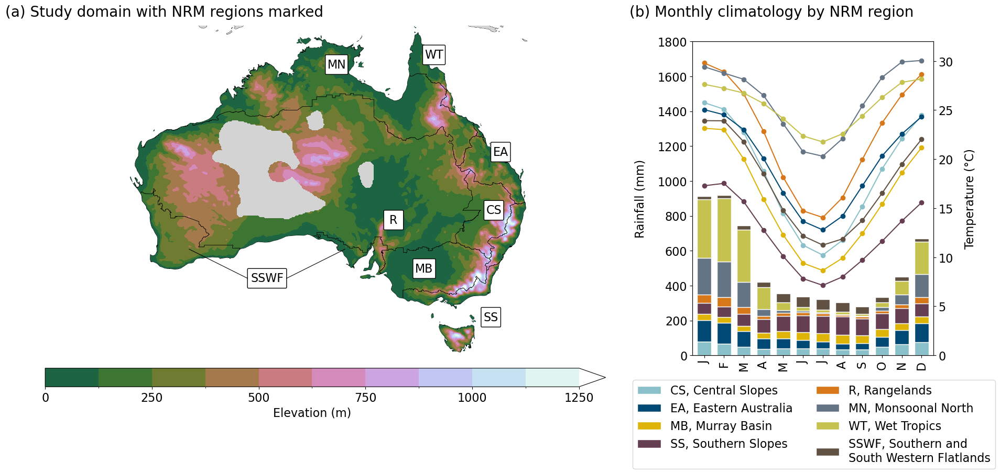

<Figure size 640x480 with 0 Axes>

In [82]:
from cartopy.feature import ShapelyFeature
from matplotlib.gridspec import GridSpec
import matplotlib.patches as mpatches
import cartopy.crs as ccrs
import matplotlib.colors as mcolors

# q_mask = np.ma.masked_greater(xr.open_dataset("/g/data/mn51/users/dh4185/agcd_v1-0-2_precip_weight_r005_daily_1960_2022fraction_ge1.nc").fraction.interp_like(xr.open_dataset('/g/data/mn51/users/jb6465/code/pca/ETOPO_sliced.nc')['z']),0.8)
# topo_domain_cut = xr.open_dataset('/g/data/mn51/users/jb6465/code/pca/ETOPO_sliced.nc')['z'].where(q_mask.mask)
q_mask = np.ma.masked_greater(xr.open_dataset("/g/data/mn51/users/dh4185/agcd_v1-0-2_precip_weight_r005_daily_1960_2022fraction_ge1.nc").fraction.interp_like(barra_topo['orog']),0.8)
topo_domain_cut = barra_topo['orog'].where(q_mask.mask)
plt.rcParams.update({'font.size': 16})
fig = plt.figure(figsize=(23, 10))
gs = GridSpec(1, 2, width_ratios=[3, 1], wspace=0)
ax2 = fig.add_subplot(gs[0], projection=ccrs.PlateCarree(central_longitude=180)) 
ax1 = fig.add_subplot(gs[1]) 
ax1.set_position([0.72, 0.25, 0.2, 0.60]) 
ax3 = ax1.twinx()
ax3.set_position([0.72, 0.25, 0.2, 0.60]) 

#cmap = cmap_dict["ipcc_chem_seq"]
contour = topo_domain_cut.plot.contourf(ax=ax2, transform=ccrs.PlateCarree(), cmap=mcolors.LinearSegmentedColormap.from_list('trunc', plt.get_cmap('cubehelix')(np.linspace(5/17, 1, 256))), zorder=2, levels=np.linspace(0, 1250, 11), extend='max', add_colorbar=False)
cbar = plt.colorbar(contour, ax=ax2, orientation='horizontal', label='Elevation (m)', shrink=0.8, aspect=30, pad=0.03)
shapefile_feature = ShapelyFeature(gdf.geometry, ccrs.PlateCarree())
ax2.add_feature(shapefile_feature, facecolor='none', edgecolor='black', linewidth=0.4, zorder=4)
ax2.add_feature(cfeature.OCEAN, zorder=10, facecolor='white', alpha=1)
ax2.set_extent([112, 154, -44, -10], crs=ccrs.PlateCarree())
ax2.add_feature(cfeature.LAND, linewidth=0.4, edgecolor='black', facecolor='lightgrey', zorder=1, alpha=1)
ax2.add_feature(cfeature.LAND, linewidth=0.4, edgecolor='black', facecolor='none', zorder=3, alpha=1)
ax2.add_feature(cfeature.BORDERS, linewidth=0.4, edgecolor='black', zorder=10, alpha=1)
ax2.plot([119, 125], [-33, -36], color='black', lw=0.8, transform=ccrs.PlateCarree(), zorder=15)
ax2.plot([129, 135], [-36, -33], color='black', lw=0.8, transform=ccrs.PlateCarree(), zorder=15)
ax2.add_patch(mpatches.FancyBboxPatch((125, -37), 4, 2, boxstyle="round,pad=0.01,rounding_size=0.1", facecolor='white', edgecolor='black', transform=ccrs.PlateCarree(), zorder=10)).set_label(ax2.text(125+2, -37+1, 'SSWF', transform=ccrs.PlateCarree(), ha='center', va='center', fontsize=16, color='black', zorder=11))
ax2.add_patch(mpatches.FancyBboxPatch((139, -31), 2, 2, boxstyle="round,pad=0.01,rounding_size=0.1", facecolor='white', edgecolor='black', transform=ccrs.PlateCarree(), zorder=10)).set_label(ax2.text(139+1, -31+1, 'R', transform=ccrs.PlateCarree(), ha='center', va='center', fontsize=16, color='black', zorder=11))
ax2.add_patch(mpatches.FancyBboxPatch((133, -15), 2.3, 2, boxstyle="round,pad=0.01,rounding_size=0.1", facecolor='white', edgecolor='black', transform=ccrs.PlateCarree(), zorder=10)).set_label(ax2.text(133+1.15, -15+1, 'MN', transform=ccrs.PlateCarree(), ha='center', va='center', fontsize=16, color='black', zorder=11))
ax2.add_patch(mpatches.FancyBboxPatch((143, -14), 2.3, 2, boxstyle="round,pad=0.01,rounding_size=0.1", facecolor='white', edgecolor='black', transform=ccrs.PlateCarree(), zorder=10)).set_label(ax2.text(143+1.15, -14+1, 'WT', transform=ccrs.PlateCarree(), ha='center', va='center', fontsize=16, color='black', zorder=11))
ax2.add_patch(mpatches.FancyBboxPatch((150, -24), 2, 2, boxstyle="round,pad=0.01,rounding_size=0.1", facecolor='white', edgecolor='black', transform=ccrs.PlateCarree(), zorder=10)).set_label(ax2.text(150+1, -24+1, 'EA', transform=ccrs.PlateCarree(), ha='center', va='center', fontsize=16, color='black', zorder=11))
ax2.add_patch(mpatches.FancyBboxPatch((149.3, -30), 2, 2, boxstyle="round,pad=0.01,rounding_size=0.1", facecolor='white', edgecolor='black', transform=ccrs.PlateCarree(), zorder=10)).set_label(ax2.text(149.3+1, -30+1, 'CS', transform=ccrs.PlateCarree(), ha='center', va='center', fontsize=16, color='black', zorder=11))
ax2.add_patch(mpatches.FancyBboxPatch((142, -36), 2.3, 2, boxstyle="round,pad=0.01,rounding_size=0.1", facecolor='white', edgecolor='black', transform=ccrs.PlateCarree(), zorder=10)).set_label(ax2.text(142+1.15, -36+1, 'MB', transform=ccrs.PlateCarree(), ha='center', va='center', fontsize=16, color='black', zorder=11))
ax2.add_patch(mpatches.FancyBboxPatch((149, -41), 2, 2, boxstyle="round,pad=0.01,rounding_size=0.1", facecolor='white', edgecolor='black', transform=ccrs.PlateCarree(), zorder=10)).set_label(ax2.text(149+1, -41+1, 'SS', transform=ccrs.PlateCarree(), ha='center', va='center', fontsize=16, color='black', zorder=11))
ax2.set_title('')
ax2.set_frame_on(False)


df_pr = pr_df.reset_index().drop('month', axis=1)
df_tas = tasmean_df.reset_index().drop('month', axis=1)
colours=['#8AC0C9', '#004975', '#DEB408', '#663E51', '#D6771A',  '#647484', '#C5C250', '#615142']
df_pr.plot(kind='bar', stacked=True, width=0.7, color=colours, ax=ax1, edgecolor='white')
# ax1.get_legend().set_visible(False)
ax1.set_ylim(0, 1800)
ax1.set_ylabel('Rainfall (mm)', labelpad=15)
df_tas.plot(kind='line', color=colours, ax=ax3, linestyle='-', marker='o')
ax3.set_ylim(0, 32)
ax1.legend(['CS, Central Slopes', 'EA, Eastern Australia', 'MB, Murray Basin', 'SS, Southern Slopes', 'R, Rangelands',  'MN, Monsoonal North', 'WT, Wet Tropics', 'SSWF, Southern and\nSouth Western Flatlands'], bbox_to_anchor=(1.28, -0.06), ncols=2, fontsize=16)
ax3.get_legend().set_visible(False)
ax3.set_xticks(range(len(df_tas)))
ax3.set_xticklabels(['J','F','M','A','M','J','J','A','S','O','N','D'], rotation=0)
ax3.set_ylabel('Temperature (°C)', labelpad=15)
fig.text(0.15, 0.92, '(a) Study domain with NRM regions marked', ha='left', va='top', fontsize=20, color='black')
fig.text(0.668, 0.92, '(b) Monthly climatology by NRM region', ha='left', va='top', fontsize=20, color='black')

plt.show()
plt.clf()

## Section 3.1 results

CPU times: user 2min 22s, sys: 11.6 s, total: 2min 33s
Wall time: 3min 29s


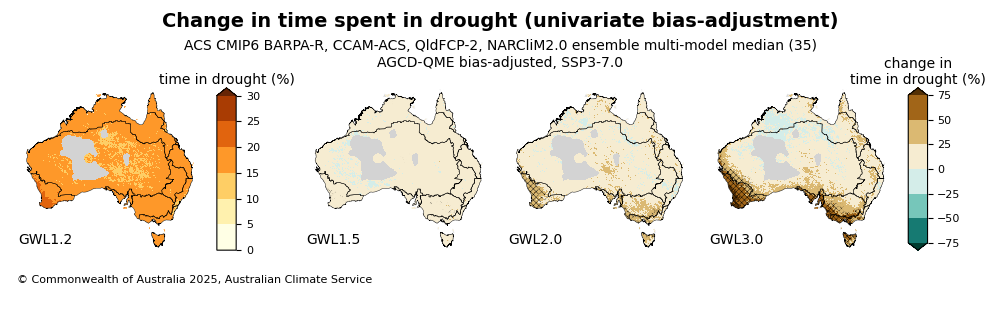

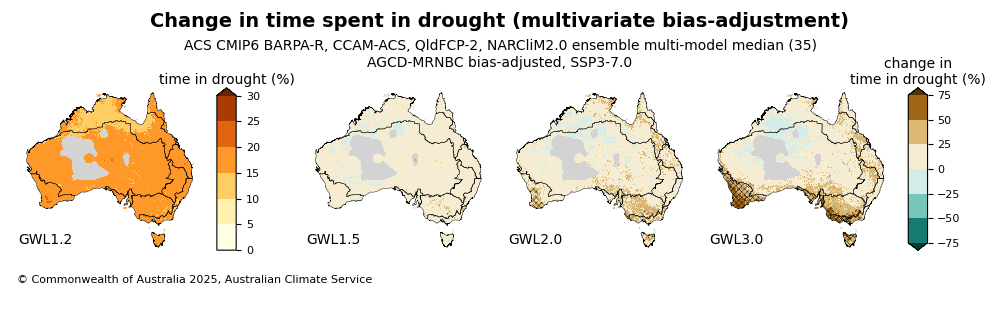

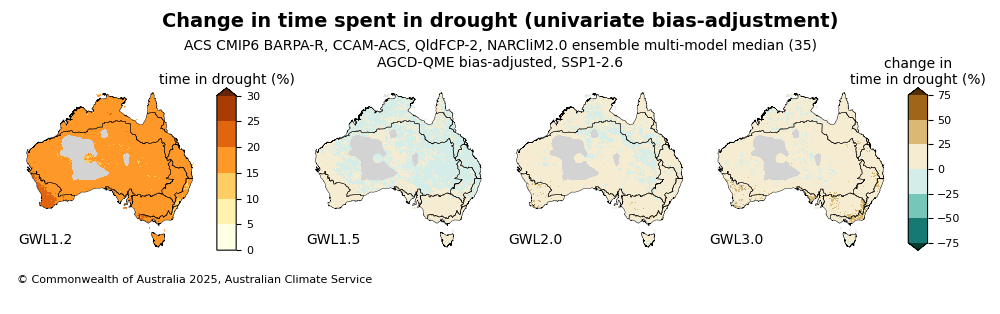

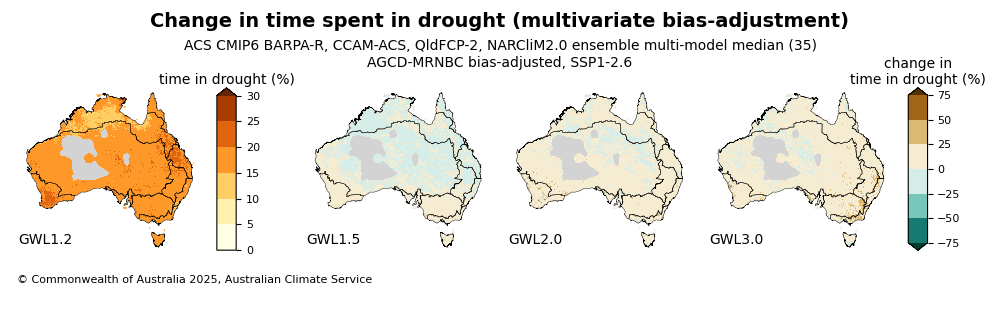

In [5]:
%%time
import glob as glob

for ssp in ['ssp370', 'ssp126']:
    for BC_TYPE in ['QME', 'MRNBC']:
        ds_gwl12 = xr.open_dataset(f"/g/data/ia39/ncra/drought_aridity/spi/downscaled_BC_5km/{BC_TYPE}-{BC_SOURCE}/ens_with_QLD_NSW/{ssp}/SPI3_pct_time_below_-1_GWL_1.2_ACS-{BC_TYPE}-{BC_SOURCE}-1960-2022_percentiles_10-50-90.nc").sel(quantile = 0.5)
        
        ds_gwl15 = xr.open_dataset(f"/g/data/ia39/ncra/drought_aridity/spi/downscaled_BC_5km/{BC_TYPE}-{BC_SOURCE}/ens_with_QLD_NSW/{ssp}/SPI3_pct_time_below_-1_MME_change_GWL1.5_to_GWL1.2_ACS-{BC_TYPE}-{BC_SOURCE}-1960-2022_percentiles_10-50-90.nc").sel(quantile = 0.5)
        ds_gwl20 = xr.open_dataset(f"/g/data/ia39/ncra/drought_aridity/spi/downscaled_BC_5km/{BC_TYPE}-{BC_SOURCE}/ens_with_QLD_NSW/{ssp}/SPI3_pct_time_below_-1_MME_change_GWL2.0_to_GWL1.2_ACS-{BC_TYPE}-{BC_SOURCE}-1960-2022_percentiles_10-50-90.nc").sel(quantile = 0.5)
        ds_gwl30 = xr.open_dataset(f"/g/data/ia39/ncra/drought_aridity/spi/downscaled_BC_5km/{BC_TYPE}-{BC_SOURCE}/ens_with_QLD_NSW/{ssp}/SPI3_pct_time_below_-1_MME_change_GWL3.0_to_GWL1.2_ACS-{BC_TYPE}-{BC_SOURCE}-1960-2022_percentiles_10-50-90.nc").sel(quantile = 0.5)
        
        files = []
        files.extend(sorted(glob.glob(f"/g/data/ia39/ncra/drought_aridity/spi/downscaled_BC_5km/{BC_TYPE}-AGCDv1/ens_with_QLD_NSW/{ssp}/*baseperiod*.nc")))
        stippling_dict={}
        for GWL in [1.5, 2.0, 3.0]:
            GWL12_file_list = [file for file in files if "GWL1.2" in file]
            GWL12_ens_list = [file[91:-35] for file in files if "GWL1.2" in file] if BC_SWITCH == False else ['_'.join((file.split('/')[-1]).split('_')[-7:-3]) for file in files if "GWL1.2" in file]
            GWL_file_list = [file for file in files if f"GWL{str(GWL)}" in file]
            GWL_ens_list = [file[91:-35] for file in files if f"GWL{str(GWL)}" in file] if BC_SWITCH == False else ['_'.join((file.split('/')[-1]).split('_')[-7:-3]) for file in files if f"GWL{str(GWL)}" in file]
           
            MME_GWL12_xr = xr.concat([xr.open_dataset(file).assign_coords(MME=ensemble) for file, ensemble in zip(GWL12_file_list, GWL12_ens_list)], dim='MME')
            MME_xr = xr.concat([xr.open_dataset(file).assign_coords(MME=ensemble) for file, ensemble in zip(GWL_file_list, GWL_ens_list)], dim='MME')
            MME_change = ((MME_xr-MME_GWL12_xr)/MME_GWL12_xr)*100
        
            positive_agreement = (np.sign(MME_change)==1)
            negative_agreement = (np.sign(MME_change)==-1)
            agreement_threshold = int(0.8 * MME_change.SPI3.shape[0])
        
            stippling_dict[GWL] = (positive_agreement.sum(dim='MME')>agreement_threshold) + (negative_agreement.sum(dim='MME')>agreement_threshold)
        
        plot_acs_hazard_1plus3(ds_gwl12=ds_gwl12['SPI3'],
                               gwl12_cmap=cm.YlOrBr,
                               gwl12_cbar_extend= "max",
                               gwl12_cbar_label= "time in drought (%)",
                               gwl12_ticks= np.arange(0,35, 5),
                               ds_gwl15=ds_gwl15['SPI3'],
                               ds_gwl20=ds_gwl20['SPI3'],
                               ds_gwl30=ds_gwl30['SPI3'],
                               stippling_gwl15=stippling_dict[1.5]['SPI3'],
                               stippling_gwl20=stippling_dict[2.0]['SPI3'],
                               stippling_gwl30=stippling_dict[3.0]['SPI3'],
                               regions = nrm_regions, #regions_dict['ncra_regions'],
                               title = f"Change in time spent in drought ({'univariate' if BC_TYPE=='QME' else 'multivariate'} bias-adjustment)",
                               date_range=f"(multi-model median, non bias-corrected)" if BC_SWITCH==False else f"ACS CMIP6 BARPA-R, CCAM-ACS, QldFCP-2, NARCliM2.0 ensemble multi-model median (35)\nAGCD-{BC_TYPE} bias-adjusted, {ssp.upper()[0:4]+'-'+ssp[4]+'.'+ssp[5:]}",
                               cmap = cmap_dict["pr_anom"].reversed(),
                               ticks = np.arange(-75, 76, 25),
                               cbar_label = "change in\ntime in drought (%)",
                               cbar_extend="both",
                               watermark="",
                               orientation="horizontal",
                               agcd_mask=True,
                               issued_date="")

### dataframe generate 

In [116]:
nrm_regions

,ClusterAb,geometry,SubClusNm,SubClusAb,ClusterNm,SupClusNm,SupClusAb
0,CS,"POLYGON ((147.957 -24.87855, 147.95711 -24.878...",Central Slopes,CS,Central Slopes,Eastern Australia,EA
1,EC,"MULTIPOLYGON (((153.53442 -28.17702, 153.53471...",East Coast (South),ECS,East Coast,Eastern Australia,EA
2,MB,"POLYGON ((145.74765 -32.21733, 145.75054 -32.2...",Murray Basin,MB,Murray Basin,Southern Australia,SA
3,MN,"POLYGON ((146.29742 -18.90381, 146.29992 -18.9...",Monsoonal North (East),MNE,Monsoonal North,Northern Australia,NA
4,R,"POLYGON ((114.14357 -22.538, 114.14296 -22.538...",Rangelands (North),RN,Rangelands,Rangelands,R
5,SS,"MULTIPOLYGON (((147.0437 -43.31381, 147.04111 ...",Southern Slopes (Vic/NSW East),SSVE,Southern Slopes,Southern Australia,SA
6,SSWF,"MULTIPOLYGON (((139.35429 -33.09761, 139.35429...",Southern and South Western Flatlands (West),SSWFW,Southern and South Western Flatlands,Southern Australia,SA
7,WT,"MULTIPOLYGON (((148.46219 -20.06725, 148.46352...",Wet Tropics,WT,Wet Tropics,Northern Australia,NA


In [117]:
name_column = "ClusterNm"
abbr_column = "ClusterAb"
shapefile_name = "nrm_regions"


nrm_regions =nrm_regions.to_crs(crs = "GDA2020")
nrm_regions.index = np.arange(0, len(nrm_regions))

regions= regionmask.from_geopandas(nrm_regions,
                                   names=name_column, 
                                   abbrevs=abbr_column, 
                                   name=shapefile_name,
                                   overlap=True) 
regions

<regionmask.Regions 'nrm_regions'>
overlap:  True

Regions:
0   CS                       Central Slopes
1   EC                           East Coast
2   MB                         Murray Basin
3   MN                      Monsoonal North
4    R                           Rangelands
5   SS                      Southern Slopes
6 SSWF Southern and South Western Flatlands
7   WT                          Wet Tropics

[8 regions]

In [182]:
files = sorted(glob.glob(f"/g/data/ia39/ncra/drought_aridity/spi/downscaled_BC_5km/QME-{BC_SOURCE}/ens_with_QLD_NSW/{SSP}/*{SSP}*.nc")) + sorted(glob.glob(f"/g/data/ia39/ncra/drought_aridity/spi/downscaled_BC_5km/MRNBC-{BC_SOURCE}/ens_with_QLD_NSW/{SSP}/*{SSP}*.nc"))

In [183]:
files[0]

'/g/data/ia39/ncra/drought_aridity/spi/downscaled_BC_5km/QME-AGCDv1/ens_with_QLD_NSW/ssp126/SPI3_pct_time_below_-1_AGCD-05i_ACCESS-CM2_ssp126_r4i1p1f1_BOM_v1-r1_baseperiod19652014_ACS-QME-AGCDv1-1979-2022_GWL1.2.nc'

In [184]:
# 35*4*2 
len(files)

280

In [187]:
%%time
q_mask = np.ma.masked_greater(xr.open_dataset("/g/data/mn51/users/dh4185/agcd_v1-0-2_precip_weight_r005_daily_1960_2022fraction_ge1.nc").fraction,0.8)
plot_df_list = []
for file in files:
    GCM = file.split('_')[-8]
    RCM = 'BARPA-R' if file.split('_')[-5] == 'BOM' else 'CCAM-v2203-SN' if file.split('_')[-5] == 'CSIRO' else file.split('_')[-5]
    BC = file.split('_')[-2].split('-')[1]
    variant_id = file.split('_')[-6]
    GWL = file.split('_')[-1][:-3]

    ensemble_member_name = f"{GCM}_{variant_id}_{RCM}_{BC}_{GWL}"
    ds_GWLx = xr.open_dataset(file).where(q_mask.mask).rename({'SPI3': ensemble_member_name})
    mask_frac = regions.mask_3D_frac_approx(ds_GWLx)
    dims = ("lat", "lon",)
    nrm_regions_df = acs_regional_stats(ds=ds_GWLx, var=ensemble_member_name, mask=mask_frac, dims = dims, how = ["mean"]).to_dataframe()
    
    plot_df_list.append(nrm_regions_df.drop(columns=['names']))

pct_time_df = pd.concat(plot_df_list, axis=1)
plot_df = pd.DataFrame([
    {"NRM-region":nrm_regions_df['abbrevs'].values[nrm_region_idx], "GCM": col.split('_')[0]+'_'+col.split('_')[1], "RCM": col.split('_')[2], "BC": col.split('_')[3], "GWL": col.split('_')[4], "pct_time": val} 
    for col in pct_time_df.drop(columns=['abbrevs']).columns 
    for nrm_region_idx, val in enumerate(pct_time_df.drop(columns=['abbrevs'])[col].values.astype('float32'))
])

plot_df.to_csv(f'/g/data/mn51/users/jb6465/data/spi_pct_time_boxplot_{SSP}.csv', index=False)

CPU times: user 35min 31s, sys: 7min 4s, total: 42min 36s
Wall time: 42min 58s


### plot box whiskers

#### absolute time in drought boxplot

In [4]:
SSP

'ssp370'

In [10]:
df = pd.read_csv(f'/g/data/mn51/users/jb6465/data/spi_pct_time_boxplot_{SSP}.csv').replace('UQ-DES', 'QldFCP-2')

In [11]:
df

,NRM-region,GCM,RCM,BC,GWL,pct_time
0,CS,ACCESS-CM2_r4i1p1f1,BARPA-R,QME,GWL1.2,13.800828
1,EC,ACCESS-CM2_r4i1p1f1,BARPA-R,QME,GWL1.2,14.109054
2,MB,ACCESS-CM2_r4i1p1f1,BARPA-R,QME,GWL1.2,17.163530
3,MN,ACCESS-CM2_r4i1p1f1,BARPA-R,QME,GWL1.2,16.745277
4,R,ACCESS-CM2_r4i1p1f1,BARPA-R,QME,GWL1.2,15.484577
...,...,...,...,...,...,...
2235,MN,UKESM1-0-LL_r1i1p1f2,NARCliM2-0-WRF412R5,MRNBC,GWL3.0,17.848516
2236,R,UKESM1-0-LL_r1i1p1f2,NARCliM2-0-WRF412R5,MRNBC,GWL3.0,20.714916
2237,SS,UKESM1-0-LL_r1i1p1f2,NARCliM2-0-WRF412R5,MRNBC,GWL3.0,28.001558
2238,SSWF,UKESM1-0-LL_r1i1p1f2,NARCliM2-0-WRF412R5,MRNBC,GWL3.0,25.970753


In [12]:
region_name_map = {
    'CS': 'Central Slopes',
    'EC': 'East Coast',
    'MB': 'Murray Basin',
    'MN': 'Monsoonal North',
    'R':  'Rangelands',
    'SS': 'Southern Slopes',
    'SSWF': 'Southern & South\nWestern Flatlands',
    'WT': 'Wet Tropics'
}

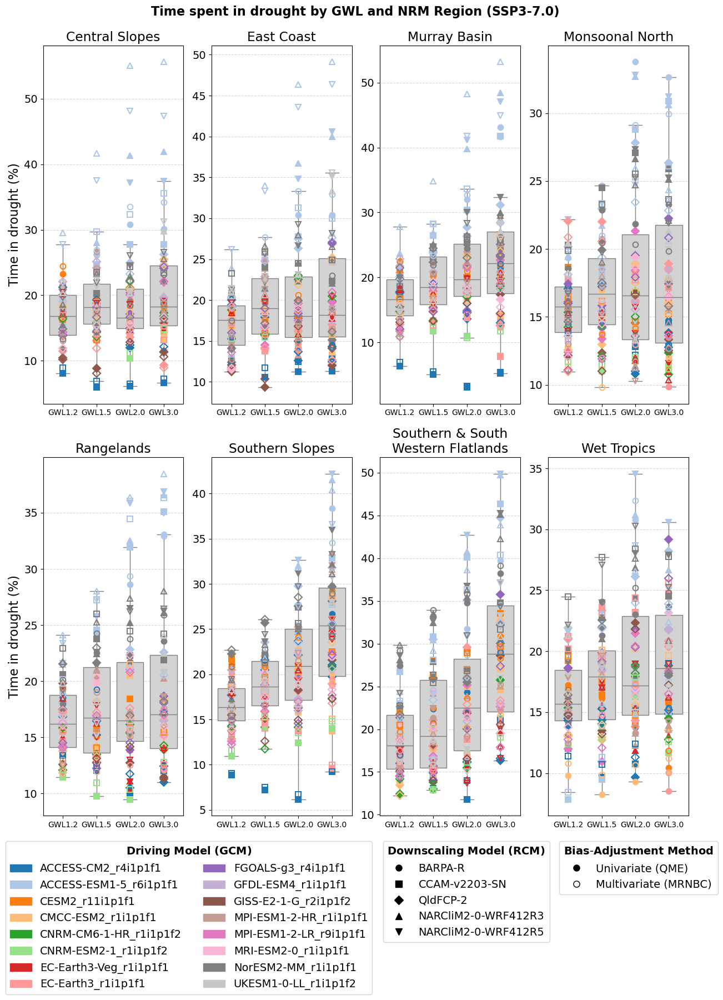

In [13]:
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
from matplotlib.gridspec import GridSpec
import numpy as np

plt.rcParams.update({'font.size': 14})

# 16 GCMs → Assign a distinct color per GCM
gcm_list = df['GCM'].unique()
# colorblind_friendly_palette = ["#66C2A5", "#FC8D62", "#8DA0CB", "#E78AC3", "#A6D854", "#FFD92F", "#E5C494", "#B3B3B3", "#1F78B4", "#33A02C", "#FB9A99", "#CAB2D6", "#FDBF6F", "#FF7F00", "#6A3D9A", "#B15928"]
# gcm_colors = dict(zip(gcm_list, colorblind_friendly_palette))
gcm_colors = dict(zip(gcm_list, sns.color_palette("tab20", len(gcm_list))))

# 5 RCMs → Assign a unique marker per RCM
rcm_list = df['RCM'].unique()
rcm_markers = ['o', 's', 'D', '^', 'v']
rcm_shapes = dict(zip(rcm_list, rcm_markers))

# BC → outline or solid
bc_fillstyle = {
    'QME': 'full',
    'MRNBC': 'none'
}

# Layout
nrm_regions = df['NRM-region'].unique()
fig = plt.figure(figsize=(15, 18))
gs = GridSpec(2, 4, width_ratios=[1, 1, 1, 1], hspace=0.15, wspace=0.2)

for i, region in enumerate(nrm_regions):
    row = i // 4
    col = i % 4
    ax = fig.add_subplot(gs[row, col])
    
    sub_df = df[df['NRM-region'] == region]
    
    sns.boxplot(data=sub_df, x='GWL', y='pct_time', ax=ax, color='lightgrey', fliersize=0)
    
    for _, rowdata in sub_df.iterrows():
        ax.plot(rowdata['GWL'], rowdata['pct_time'],
                marker=rcm_shapes[rowdata['RCM']],
                markersize=7,
                color=gcm_colors[rowdata['GCM']],
                markerfacecolor=gcm_colors[rowdata['GCM']] if bc_fillstyle[rowdata['BC']] == 'full' else 'none',
                markeredgecolor=gcm_colors[rowdata['GCM']],
                markeredgewidth=1.5)
    ax.tick_params(axis='x', labelsize=10)
    ax.set_title(region_name_map.get(region, region))
    ax.set_ylabel('Time in drought (%)' if i in [0,4] else '', size=16)
    ax.set_xlabel('')
    ax.grid(True, axis='y', linestyle='--', alpha=0.5)

# GCM legend
legend1 = fig.legend(handles=[mpatches.Patch(color=gcm_colors[gcm], label=gcm) for gcm in gcm_list],
                     title=r"$\bf{Driving\ Model\ (GCM)}$",
                     loc='upper center',
                     bbox_to_anchor=(0.3, 0.09),
                     ncol=2,
                     fontsize=14,
                     title_fontsize=14,)

# RCM legend
space_padding = [mlines.Line2D([], [], color='white', marker='o', linestyle='None', markersize=8, markerfacecolor='white', label=''), mlines.Line2D([], [], color='white', marker='o', linestyle='None', markersize=8, markerfacecolor='white', label=''), mlines.Line2D([], [], color='white', marker='o', linestyle='None', markersize=8, markerfacecolor='white', label='')]
legend2 = fig.legend(handles=[mlines.Line2D([], [], color='black', marker=rcm_shapes[rcm], linestyle='None', markersize=8, label=rcm) for rcm in rcm_list],
                     title=r"$\bf{Downscaling\ Model\ (RCM)}$",
                     loc='upper center',
                     bbox_to_anchor=(0.633, 0.09),
                     ncol=1,
                     fontsize=14,
                     title_fontsize=14)

# BC Method legend
legend3 = fig.legend(handles=[mlines.Line2D([], [], color='black', marker='o', linestyle='None', markersize=8, markerfacecolor='black', label='Univariate (QME)'),
                              mlines.Line2D([], [], color='black', marker='o', linestyle='None', markersize=8, markerfacecolor='none', label='Multivariate (MRNBC)')],
                     title=r"$\bf{Bias\text{-}Adjustment\ Method}$",
                     loc='upper center',
                     bbox_to_anchor=(0.84, 0.09),
                     ncol=1,
                     fontsize=14,
                     title_fontsize=14)

fig.suptitle(f"Time spent in drought by GWL and NRM Region ({SSP.upper()[0:4]+'-'+SSP[4]+'.'+SSP[5:]})", fontsize=16, y=0.92, fontweight='bold')
plt.show()


#### relative time in drought boxplot

In [52]:
SSP

'ssp370'

In [53]:
df = pd.read_csv(f'/g/data/mn51/users/jb6465/data/spi_pct_time_boxplot_{SSP}.csv').replace('UQ-DES', 'QldFCP-2')

In [54]:
df['pct_change'] = df.apply(
    lambda row: None if row['GWL'] == 'GWL1.2' else (
        ((row['pct_time'] - df[
            (df['NRM-region'] == row['NRM-region']) &
            (df['GCM'] == row['GCM']) &
            (df['RCM'] == row['RCM']) &
            (df['BC'] == row['BC']) &
            (df['GWL'] == 'GWL1.2')
        ]['pct_time'].values[0]) /
        df[
            (df['NRM-region'] == row['NRM-region']) &
            (df['GCM'] == row['GCM']) &
            (df['RCM'] == row['RCM']) &
            (df['BC'] == row['BC']) &
            (df['GWL'] == 'GWL1.2')
        ]['pct_time'].values[0]) * 100
    ),
    axis=1
)


In [55]:
df = df[df['GWL'].isin(['GWL1.5', 'GWL2.0', 'GWL3.0'])].drop(columns=['pct_time'])

In [56]:
region_name_map = {
    'CS': 'Central Slopes',
    'EC': 'East Coast',
    'MB': 'Murray Basin',
    'MN': 'Monsoonal North',
    'R':  'Rangelands',
    'SS': 'Southern Slopes',
    'SSWF': 'Southern & South\nWestern Flatlands',
    'WT': 'Wet Tropics'
}


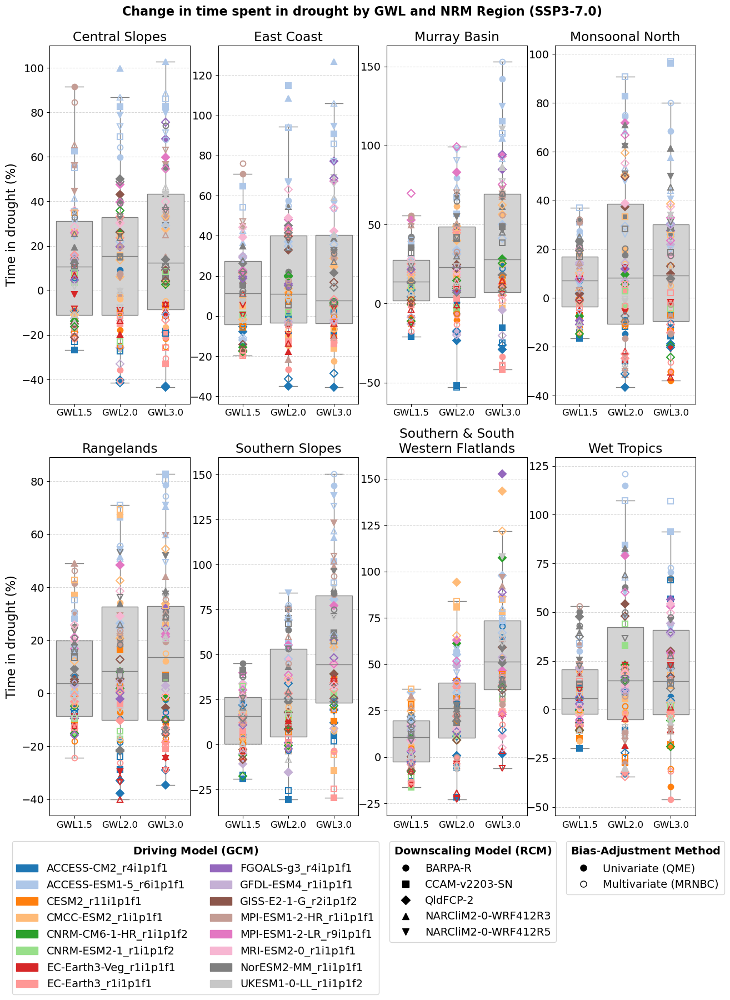

In [57]:
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
from matplotlib.gridspec import GridSpec
import numpy as np

plt.rcParams.update({'font.size': 14})

# 16 GCMs → Assign a distinct color per GCM
gcm_list = df['GCM'].unique()
# colorblind_friendly_palette = ["#66C2A5", "#FC8D62", "#8DA0CB", "#E78AC3", "#A6D854", "#FFD92F", "#E5C494", "#B3B3B3", "#1F78B4", "#33A02C", "#FB9A99", "#CAB2D6", "#FDBF6F", "#FF7F00", "#6A3D9A", "#B15928"]
# gcm_colors = dict(zip(gcm_list, colorblind_friendly_palette))
gcm_colors = dict(zip(gcm_list, sns.color_palette("tab20", len(gcm_list))))

# 5 RCMs → Assign a unique marker per RCM
rcm_list = df['RCM'].unique()
rcm_markers = ['o', 's', 'D', '^', 'v']
rcm_shapes = dict(zip(rcm_list, rcm_markers))

# BC → outline or solid
bc_fillstyle = {
    'QME': 'full',
    'MRNBC': 'none'
}

# Layout
nrm_regions = df['NRM-region'].unique()
fig = plt.figure(figsize=(15, 18))
gs = GridSpec(2, 4, width_ratios=[1, 1, 1, 1], hspace=0.15, wspace=0.2)

for i, region in enumerate(nrm_regions):
    row = i // 4
    col = i % 4
    ax = fig.add_subplot(gs[row, col])
    
    sub_df = df[df['NRM-region'] == region]
    
    sns.boxplot(data=sub_df, x='GWL', y='pct_change', ax=ax, color='lightgrey', fliersize=0)
    
    for _, rowdata in sub_df.iterrows():
        ax.plot(rowdata['GWL'], rowdata['pct_change'],
                marker=rcm_shapes[rowdata['RCM']],
                markersize=7,
                color=gcm_colors[rowdata['GCM']],
                markerfacecolor=gcm_colors[rowdata['GCM']] if bc_fillstyle[rowdata['BC']] == 'full' else 'none',
                markeredgecolor=gcm_colors[rowdata['GCM']],
                markeredgewidth=1.5)
    ax.tick_params(axis='x', labelsize=12)
    ax.set_title(region_name_map.get(region, region))
    ax.set_ylabel('Time in drought (%)' if i in [0,4] else '', size=16)
    ax.set_xlabel('')
    ax.grid(True, axis='y', linestyle='--', alpha=0.5)

# GCM legend
legend1 = fig.legend(handles=[mpatches.Patch(color=gcm_colors[gcm], label=gcm) for gcm in gcm_list],
                     title=r"$\bf{Driving\ Model\ (GCM)}$",
                     loc='upper center',
                     bbox_to_anchor=(0.3, 0.09),
                     ncol=2,
                     fontsize=14,
                     title_fontsize=14,)

# RCM legend
space_padding = [mlines.Line2D([], [], color='white', marker='o', linestyle='None', markersize=8, markerfacecolor='white', label=''), mlines.Line2D([], [], color='white', marker='o', linestyle='None', markersize=8, markerfacecolor='white', label=''), mlines.Line2D([], [], color='white', marker='o', linestyle='None', markersize=8, markerfacecolor='white', label='')]
legend2 = fig.legend(handles=[mlines.Line2D([], [], color='black', marker=rcm_shapes[rcm], linestyle='None', markersize=8, label=rcm) for rcm in rcm_list],
                     title=r"$\bf{Downscaling\ Model\ (RCM)}$",
                     loc='upper center',
                     bbox_to_anchor=(0.633, 0.09),
                     ncol=1,
                     fontsize=14,
                     title_fontsize=14)

# BC Method legend
legend3 = fig.legend(handles=[mlines.Line2D([], [], color='black', marker='o', linestyle='None', markersize=8, markerfacecolor='black', label='Univariate (QME)'),
                              mlines.Line2D([], [], color='black', marker='o', linestyle='None', markersize=8, markerfacecolor='none', label='Multivariate (MRNBC)')],
                     title=r"$\bf{Bias\text{-}Adjustment\ Method}$",
                     loc='upper center',
                     bbox_to_anchor=(0.84, 0.09),
                     ncol=1,
                     fontsize=14,
                     title_fontsize=14)

fig.suptitle(f"Change in time spent in drought by GWL and NRM Region ({SSP.upper()[0:4]+'-'+SSP[4]+'.'+SSP[5:]})", fontsize=16, y=0.92, fontweight='bold')
plt.show()


## Section 3.2 results

### IFD compute

In [4]:
def compute_ifd_metrics(input_ts):
    import warnings
    import logging
    warnings.filterwarnings('ignore')
    logging.getLogger("distributed.worker.memory").setLevel(logging.ERROR)
    logging.getLogger('flox').setLevel(logging.WARNING)
    
    input_binary_ts = (input_ts <= -1).astype(int)
    input_binary_ts = np.ma.masked_where(input_binary_ts==0, input_binary_ts)
    
    segments_unmasked = np.ma.clump_unmasked(np.ma.masked_invalid(input_binary_ts))
    events = [segment for segment in segments_unmasked if segment.stop - segment.start > 2] #event defined as at least three consecutive months below threshold
    
    duration = np.ma.average([(event.stop - event.start) for event in events])
    frequency = len(events) / 2 
    mean_int = np.ma.average([np.ma.average(input_ts[event.start:event.stop]) for event in events])
    max_int = np.ma.average([np.ma.min(input_ts[event.start:event.stop]) for event in events])
    cum_int = np.ma.average([np.ma.sum(input_ts[event.start:event.stop]) for event in events])
    
    metrics = np.array([duration, frequency, mean_int, max_int, cum_int])
    
    return metrics

In [5]:
import glob as glob
qme_files = []
qme_files.extend(sorted(glob.glob(f"/g/data/ia39/ncra/drought_aridity/spi/downscaled_BC_5km/QME-{BC_SOURCE}/full_period/{SSP}/*AGCD-05i*.nc")))

mrnbc_files = []
mrnbc_files.extend(sorted(glob.glob(f"/g/data/ia39/ncra/drought_aridity/spi/downscaled_BC_5km/MRNBC-{BC_SOURCE}/full_period/{SSP}/*AGCD-05i*.nc")))

In [6]:
len(qme_files+mrnbc_files)

70

In [7]:
for spi_file in qme_files+mrnbc_files:
    target_model = spi_file.split('/')[-1].split('_')[2]
    variant_id = spi_file.split('/')[-1].split('_')[4]
    spi_grid = xr.open_dataset(spi_file)

    for GWL in [1.2, 1.5, 2.0, 3.0]:
        if os.path.isfile(f"/g/data/mn51/users/jb6465/data/spi_ifd_metrics/{SSP}/GWL{GWL}_IFDmetrics_{spi_file.split('/')[-1]}") == False:
            print(f"--> Computing GWL{GWL}_IFDmetrics_{spi_file.split('/')[-1]}")
            syear, eyear = get_GWL_syear_eyear('CMIP6',target_model,variant_id,'ssp370',GWL) #have to use this instead of get_GWL_timeslice bc of cftime errors
            GWL_timeslice = xr.open_dataset(spi_file).sel(time=xr.open_dataset(spi_file)['time'].dt.year.isin(range(syear, eyear+1)))
            
            ifd_metric = xr.apply_ufunc(
                            compute_ifd_metrics,
                            GWL_timeslice['SPI3'].chunk({'time':-1, 'lat':'auto', 'lon':'auto'}),
                            input_core_dims=[['time']],
                            output_core_dims=[['metric']], 
                            vectorize=True,
                            dask='parallelized',
                            output_dtypes=[float],  
                            dask_gufunc_kwargs={'output_sizes': {'metric': 5}, 'allow_rechunk': True}
                            ) 
            ifd_metric = ifd_metric.transpose('metric', 'lat', 'lon')
            ifd_metric.coords['metric'] = ['duration', 'frequency', 'mean_intensity', 'max_intensity', 'cumulative_intensity']
    
            ifd_metric.to_netcdf(f"/g/data/mn51/users/jb6465/data/spi_ifd_metrics/{SSP}/GWL{GWL}_IFDmetrics_{spi_file.split('/')[-1]}", encoding={'SPI3': {'zlib': True, 'complevel': 5, 'dtype':'float32'}})
            
            del ifd_metric
            gc.collect()
        # else:
        #     print(f"GWL{GWL}_IFDmetrics_{spi_file.split('/')[-1]} file exists. Pass.")

### IFD plot

CPU times: user 4min 31s, sys: 7.95 s, total: 4min 39s
Wall time: 4min 53s


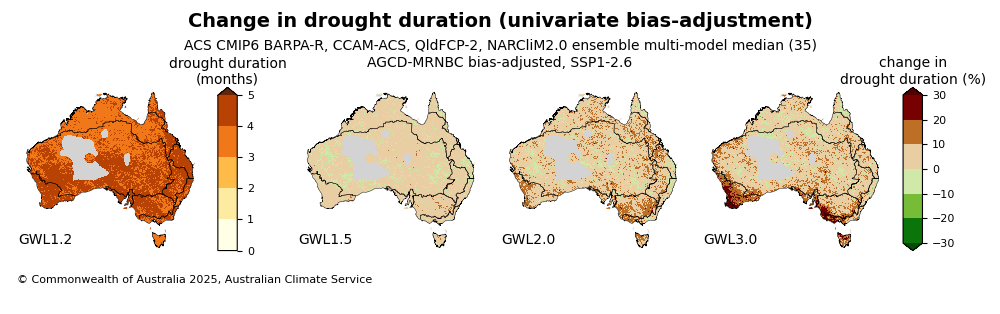

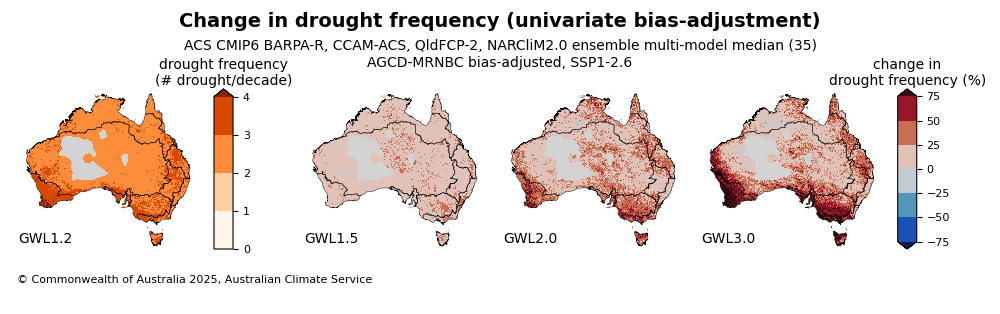

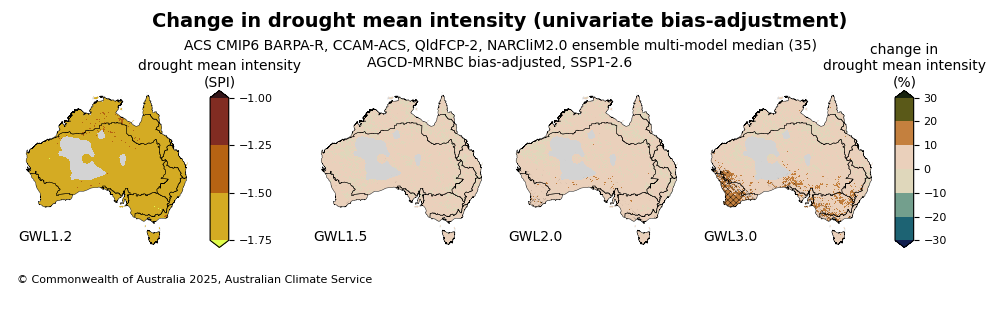

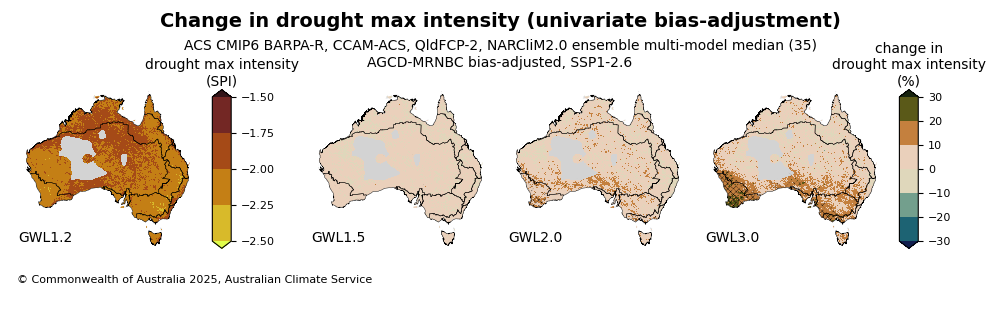

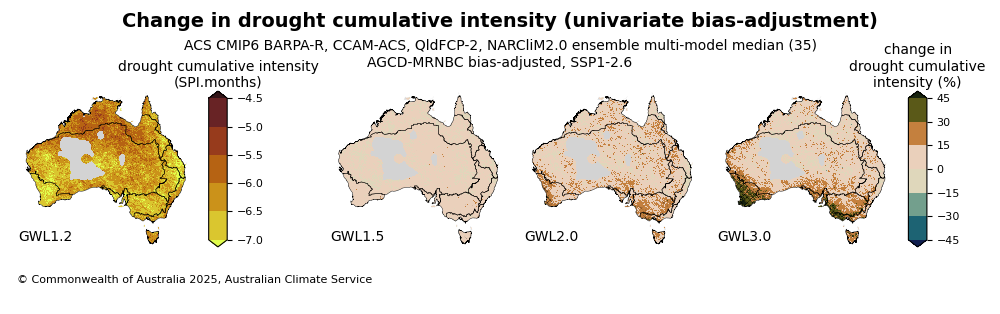

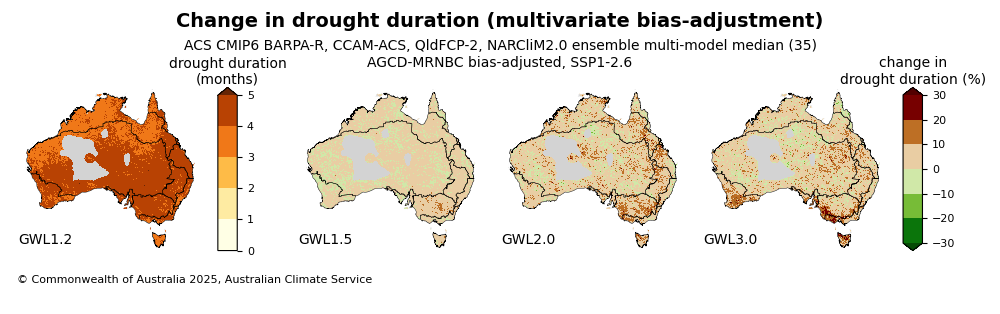

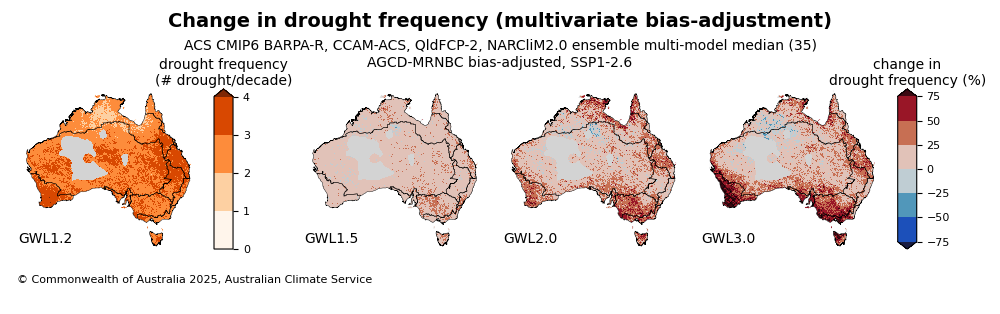

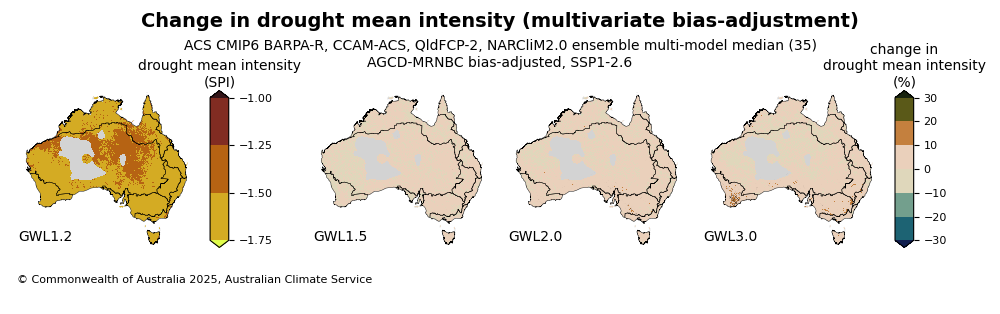

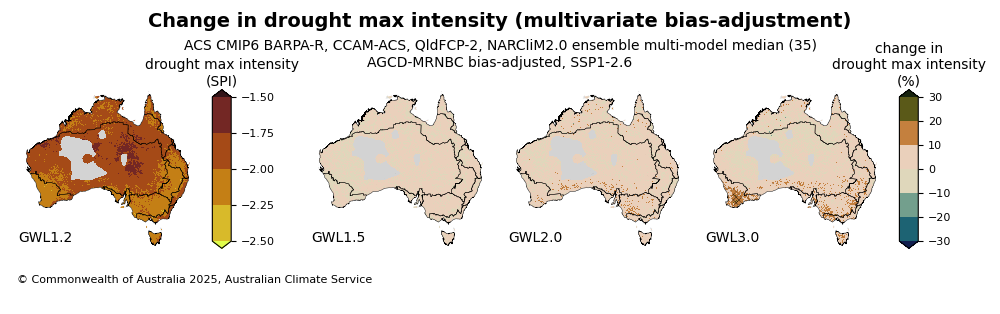

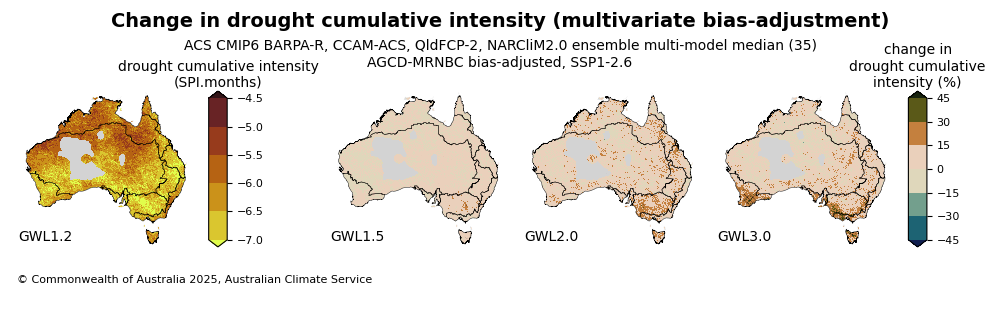

In [27]:
%%time
import glob as glob
import cmocean

metric_units = ["months", "# drought/decade", "SPI", "SPI", "SPI.months" ]

cmap12_list = [cm.YlOrBr, cmap_dict["Oranges"], cmap_dict["pr_chance_extremes"], cmap_dict["pr_chance_extremes"], cmap_dict["pr_chance_extremes"]]
GWL12_ticks = [np.arange(0,5.1, 1), np.arange(0,4.1, 1), np.arange(-1.75,-0.99, 0.25), np.arange(-2.5,-1.49, 0.25), np.arange(-7,-4, 0.5)]

cmapchange_list = [cmap_dict["anom_veg_1"].reversed(), cmap_dict["xts_freq_anom"].reversed(), cmocean.cm.tarn_r, cmocean.cm.tarn_r, cmocean.cm.tarn_r]
GWLx_ticks = [np.arange(-30, 31, 10), np.arange(-75, 76, 25), np.arange(-30, 31, 10), np.arange(-30, 31, 10), np.arange(-45, 46, 15) ]

for bc_method in ['QME', 'MRNBC']:
    ifd_grids = []
    ifd_grids.extend(sorted(glob.glob(f"/g/data/mn51/users/jb6465/data/spi_ifd_metrics/{SSP}/*{bc_method}*{BC_SOURCE}*.nc")))
    
    GWLxr_dict = {}
    stippling_dict = {}
    
    for GWL in [1.5, 2.0, 3.0]:
        GWLx_files = [file for file in ifd_grids if f"GWL{GWL}" in file] 
        GWLx_ens_list = ['_'.join((file.split('/')[-1]).split('_')[-7:-3]) for file in GWLx_files]
        GWLx_xr = xr.concat([xr.open_dataset(file).assign_coords(MME=ensemble) for file, ensemble in zip(GWLx_files, GWLx_ens_list)], dim='MME')
        
        GWL12_files = [file for file in ifd_grids if "GWL1.2" in file]
        GWL12_ens_list = ['_'.join((file.split('/')[-1]).split('_')[-7:-3]) for file in GWL12_files]
        GWL12_xr = xr.concat([xr.open_dataset(file).assign_coords(MME=ensemble) for file, ensemble in zip(GWL12_files, GWL12_ens_list)], dim='MME')
    
        MME_change = ((GWLx_xr-GWL12_xr)/GWL12_xr)*100
        positive_agreement = (np.sign(MME_change)==1)
        negative_agreement = (np.sign(MME_change)==-1)
        agreement_threshold = int(0.8 * MME_change.SPI3.shape[0])
    
        GWLxr_dict[GWL] = MME_change
        stippling_dict[GWL] = (positive_agreement.sum(dim='MME')>agreement_threshold) + (negative_agreement.sum(dim='MME')>agreement_threshold)
    
    for plot_metric_idx, plot_metric in enumerate(['duration', 'frequency', 'mean_intensity', 'max_intensity', 'cumulative_intensity']):
        plot_acs_hazard_1plus3(ds_gwl12=GWL12_xr['SPI3'].sel(metric=plot_metric).median(dim='MME'),
                               gwl12_cmap=cmap12_list[plot_metric_idx],
                               gwl12_cbar_extend= "max" if plot_metric in ['duration', 'frequency'] else "both",
                               gwl12_cbar_label= f"drought {plot_metric.replace('_', ' ')}\n({metric_units[plot_metric_idx]})",
                               gwl12_ticks= GWL12_ticks[plot_metric_idx],
                               ds_gwl15=GWLxr_dict[1.5]['SPI3'].sel(metric=plot_metric).median(dim='MME'),
                               ds_gwl20=GWLxr_dict[2.0]['SPI3'].sel(metric=plot_metric).median(dim='MME'),
                               ds_gwl30=GWLxr_dict[3.0]['SPI3'].sel(metric=plot_metric).median(dim='MME'),
                               stippling_gwl15=stippling_dict[1.5]['SPI3'].sel(metric=plot_metric),
                               stippling_gwl20=stippling_dict[2.0]['SPI3'].sel(metric=plot_metric),
                               stippling_gwl30=stippling_dict[3.0]['SPI3'].sel(metric=plot_metric),
                               regions = nrm_regions,#regions_dict['nrm_regions'],
                               title = f"Change in drought {plot_metric.replace('_', ' ')} ({'univariate' if bc_method=='QME' else 'multivariate'} bias-adjustment)",
                               date_range=f"ACS CMIP6 BARPA-R, CCAM-ACS, QldFCP-2, NARCliM2.0 ensemble multi-model median (35)\nAGCD-{BC_TYPE} bias-adjusted, {ssp.upper()[0:4]+'-'+ssp[4]+'.'+ssp[5:]}",
                               cmap = cmapchange_list[plot_metric_idx], 
                               ticks = GWLx_ticks[plot_metric_idx],
                               cbar_label = f"change in\ndrought {plot_metric.replace('_', ' ')} (%)",
                               cbar_extend="both",
                               watermark="",
                               orientation="horizontal",
                               agcd_mask=True,
                               issued_date="")


### Heatmaps

In [36]:
# NRM cluster regions
gdf = gpd.read_file(("/g/data/ia39/aus-ref-clim-data-nci/shapefiles/data/nrm_regions/nrm_regions.shp"))
nrm_regions = gdf.dissolve(by="ClusterAb").reset_index()
nrm_regions

,ClusterAb,geometry,SubClusNm,SubClusAb,ClusterNm,SupClusNm,SupClusAb
0,CS,"POLYGON ((147.957 -24.87855, 147.95711 -24.878...",Central Slopes,CS,Central Slopes,Eastern Australia,EA
1,EC,"MULTIPOLYGON (((153.53442 -28.17702, 153.53471...",East Coast (South),ECS,East Coast,Eastern Australia,EA
2,MB,"POLYGON ((145.74765 -32.21733, 145.75054 -32.2...",Murray Basin,MB,Murray Basin,Southern Australia,SA
3,MN,"POLYGON ((146.29742 -18.90381, 146.29992 -18.9...",Monsoonal North (East),MNE,Monsoonal North,Northern Australia,NA
4,R,"POLYGON ((114.14357 -22.538, 114.14296 -22.538...",Rangelands (North),RN,Rangelands,Rangelands,R
5,SS,"MULTIPOLYGON (((147.0437 -43.31381, 147.04111 ...",Southern Slopes (Vic/NSW East),SSVE,Southern Slopes,Southern Australia,SA
6,SSWF,"MULTIPOLYGON (((139.35429 -33.09761, 139.35429...",Southern and South Western Flatlands (West),SSWFW,Southern and South Western Flatlands,Southern Australia,SA
7,WT,"MULTIPOLYGON (((148.46219 -20.06725, 148.46352...",Wet Tropics,WT,Wet Tropics,Northern Australia,NA


In [37]:
name_column = "ClusterNm"
abbr_column = "ClusterAb"
shapefile_name = "nrm_regions"


nrm_regions =nrm_regions.to_crs(crs = "GDA2020")
nrm_regions.index = np.arange(0, len(nrm_regions))

regions= regionmask.from_geopandas(nrm_regions,
                                   names=name_column, 
                                   abbrevs=abbr_column, 
                                   name=shapefile_name,
                                   overlap=True) 
regions

<regionmask.Regions 'nrm_regions'>
overlap:  True

Regions:
0   CS                       Central Slopes
1   EC                           East Coast
2   MB                         Murray Basin
3   MN                      Monsoonal North
4    R                           Rangelands
5   SS                      Southern Slopes
6 SSWF Southern and South Western Flatlands
7   WT                          Wet Tropics

[8 regions]

In [38]:
def plot_heatmap(plot_df, GWL_level, metric, cmap_colors, vmin, vmax, p10_p90_annotation_switch=False):
    import seaborn as sns
    import matplotlib.pyplot as plt
    import pandas as pd
    from matplotlib.colors import ListedColormap

    min_max_extent = {1.5:10, 2.0:15, 3.0:20}
    plt.rcParams.update({'font.size': 32})
    plt.figure(figsize=(40, 7)) #plt.figure(figsize=(18, 7))
    cmap = ListedColormap(cmap_colors)
    
    ax = sns.heatmap(plot_df, annot=True, cmap=cmap, linewidth=2, fmt='.0f',
                     cbar=False,
                     center=0,
                     vmin=vmin,
                     vmax=vmax,
                     yticklabels=list(nrm_regions['ClusterAb']),
                     xticklabels=[key[:-5].replace('_', ' ').replace('BOM', 'BARPA').replace('CSIRO', 'CCAM') for key in plot_df.columns] if GWL_level==3.0 else '')
    
    ax.text(len(plot_df.columns) + 0.85, - 1, 'MME\nMedian', color='black' if GWL_level==1.5 else 'white', ha='center', va='center', size=28)
    # ax.text(len(plot_df.columns) + 0.23, 12, r"$\bf{Bold}$" + ' = at least\n66% of ensemble\nmembers agree on \nsign of the change' , size=16, ha='left', va='center', bbox=dict(boxstyle="round,pad=0.7", edgecolor="black", facecolor="none", linewidth=0.25))
    for i, row in plot_df.iterrows():
        median = row.median()
        sign_agreement = ((row>0).sum()/len(row)) if median > 0 else ((row<0).sum()/len(row))
        fontweight = 'bold' if sign_agreement >= 0.8 else 'normal'
        ax.text(len(plot_df.columns) + 0.85, i + 0.5, f'{int(median)}', ha='center', va='center', fontweight=fontweight, fontsize=35)

        if p10_p90_annotation_switch:
            sorted_values = row.sort_values()
            n = len(sorted_values)
            p10_idx = int(np.floor(0.1 * (n - 1)))  # 10th percentile index
            p90_idx = int(np.floor(0.9 * (n - 1)))  # 90th percentile index
            
            p10_col = sorted_values.index[p10_idx]
            p90_col = sorted_values.index[p90_idx]
            
            p10_loc = plot_df.columns.get_loc(p10_col)
            p90_loc = plot_df.columns.get_loc(p90_col)
        
            # Annotate the heatmap
            ax.text(p90_loc + 0.85, i + 0.8, '•', color='red', ha='center', va='center', fontsize=50)
            ax.text(p10_loc + 0.85, i + 0.8, '•', color='blue', ha='center', va='center', fontsize=50)

    #make sure zero values are not coloured positively
    for text in ax.texts:
        x, y = text.get_position()
        if (text.get_text()=='0' or text.get_text()=='-0') and x<34:
            ax.text(x, y, '  0 ', ha='center', va='center', bbox=dict(pad=12, edgecolor="none", facecolor="#ebe8e8"), size=26)
    ax.set_ylabel(f'GWL {GWL_level}°C', fontweight='bold', size=40, labelpad=15)    
    # ax.set_title(f'Change in drought {metric} for GWL {str(GWL_level)} relative to GWL 1.2', fontweight='bold', pad=30)
    ax.set_title(f'Full ensemble change in drought {metric.replace("_"," ")} per NRM region for GWL 1.5°C, 2.0°C, 3.0°C relative to GWL 1.2°C' if GWL_level==1.5 else '', fontweight='bold', pad=95, size=35)
    ssp_label = SSP.upper()[0:4]+'-'+SSP[4]+'.'+SSP[5:]
    # ax.text(17, -0.6, f'\n (AGCD quality mask applied, AGCD-{bc_method} bias-adjusted, {ssp_label})' if GWL_level==1.5 else '', ha='center', va='center', size=30)
    ax.text(17, -0.85,  r"$\bf{Bold\ area\ averaged\ MME\ median}$" + ' = at least 80% of ensemble members agree on sign of the change' if GWL_level==1.5 else '', color='#737373', ha='center', va='center', size=28, bbox=dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="none", linewidth=0.35))
    plt.show()
    plt.clf()
    return

---> Plotting GWL1.5


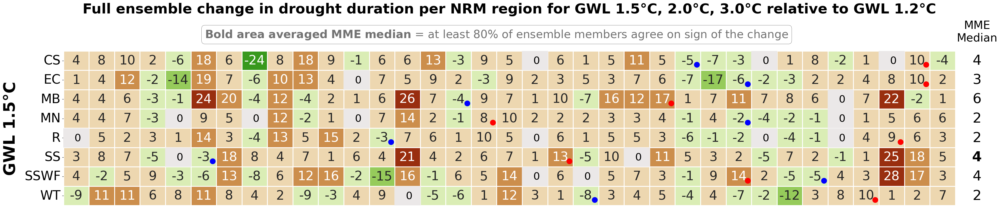

<Figure size 640x480 with 0 Axes>

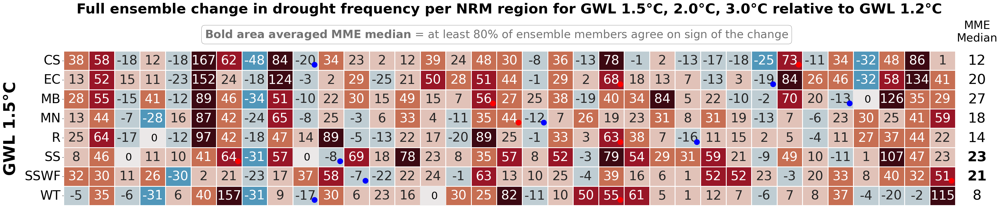

<Figure size 640x480 with 0 Axes>

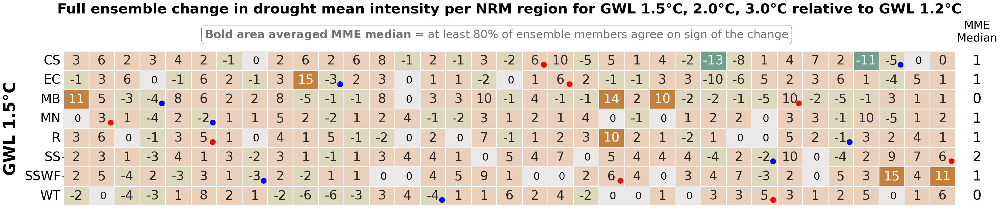

<Figure size 640x480 with 0 Axes>

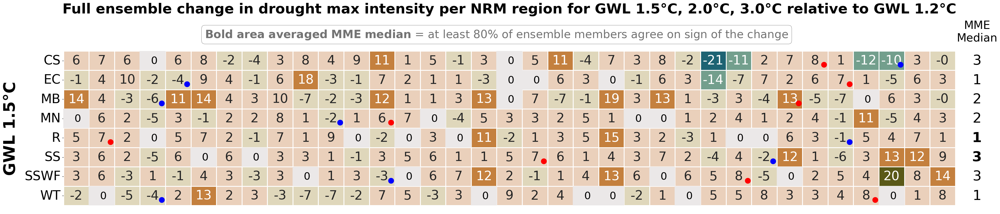

<Figure size 640x480 with 0 Axes>

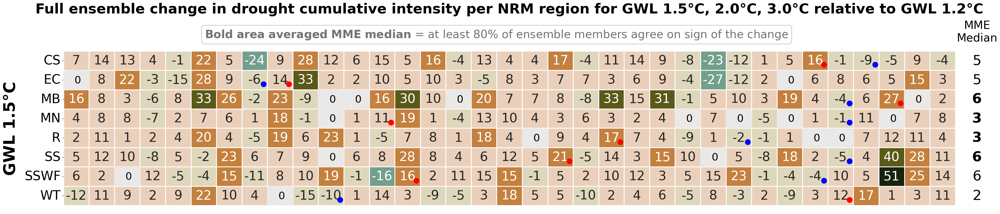

---> Plotting GWL2.0


<Figure size 640x480 with 0 Axes>

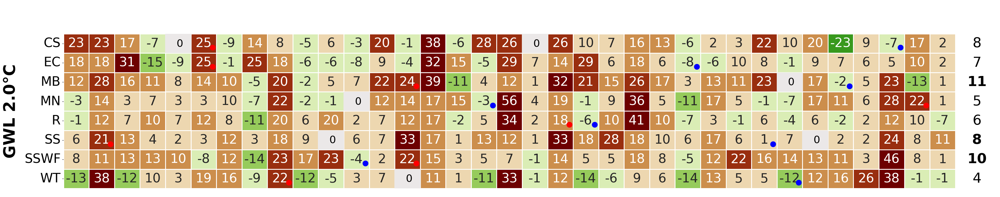

<Figure size 640x480 with 0 Axes>

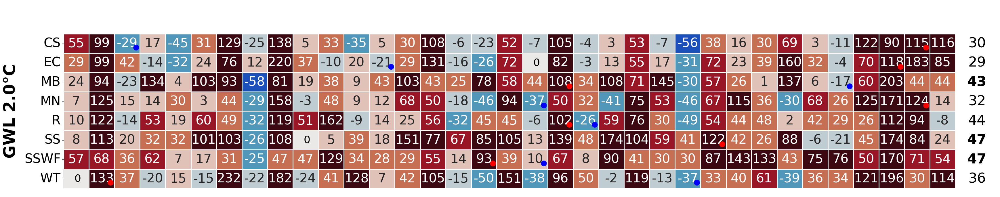

<Figure size 640x480 with 0 Axes>

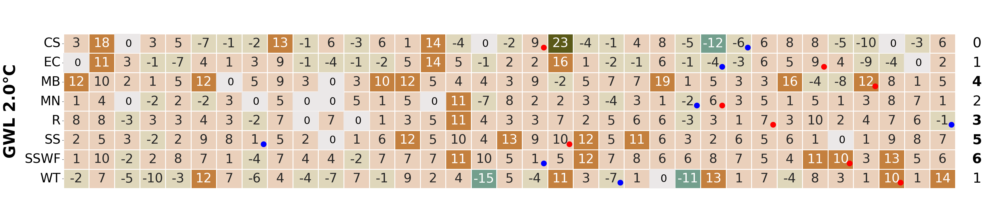

<Figure size 640x480 with 0 Axes>

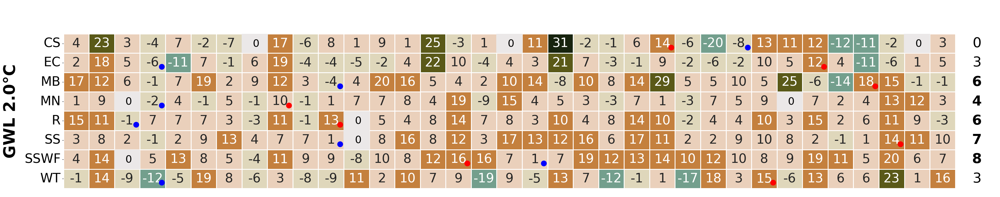

<Figure size 640x480 with 0 Axes>

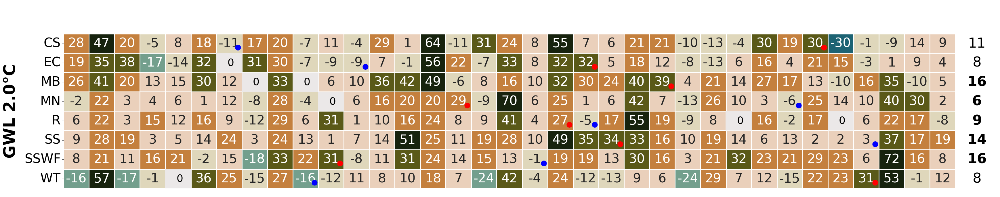

---> Plotting GWL3.0


<Figure size 640x480 with 0 Axes>

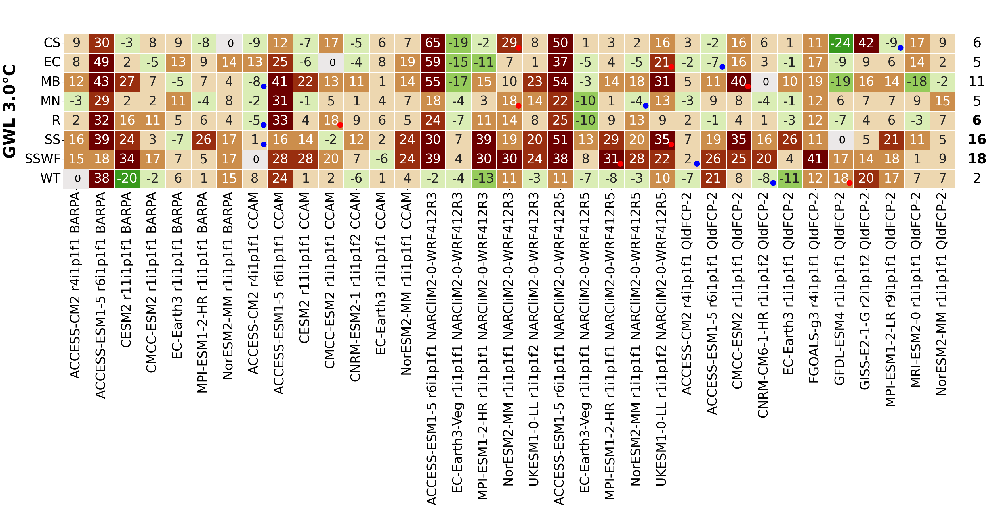

<Figure size 640x480 with 0 Axes>

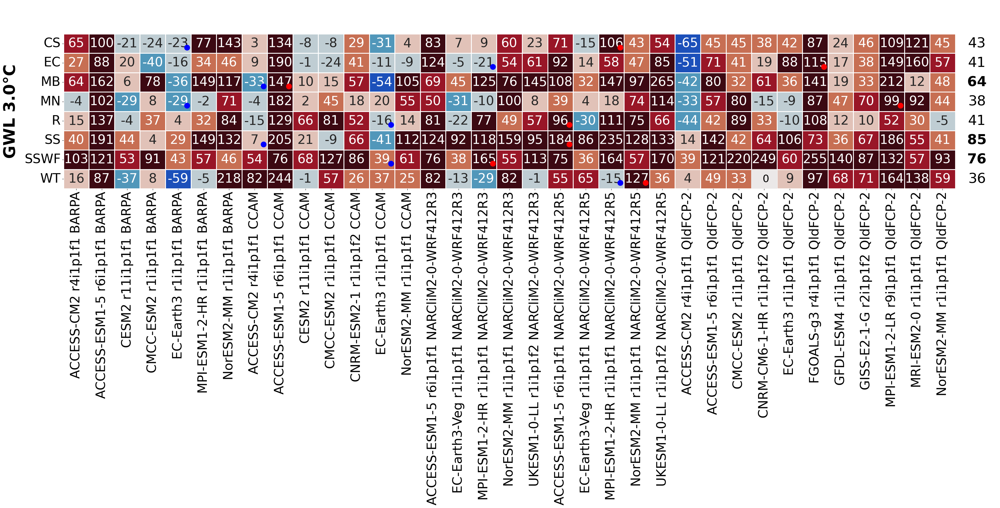

<Figure size 640x480 with 0 Axes>

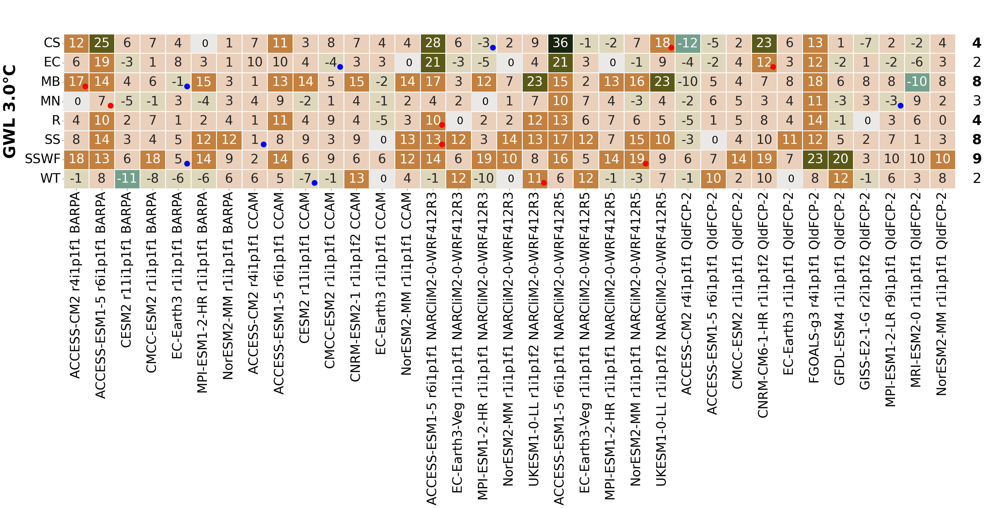

<Figure size 640x480 with 0 Axes>

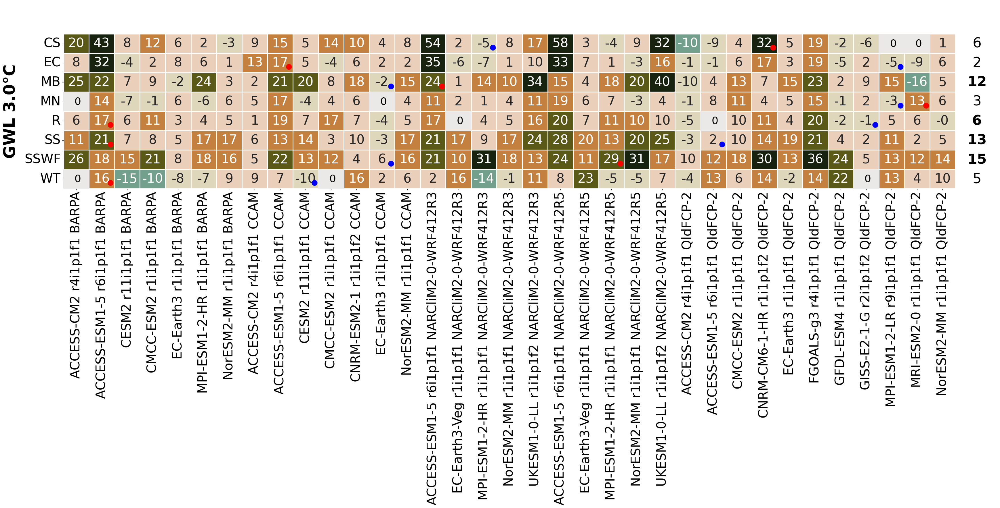

<Figure size 640x480 with 0 Axes>

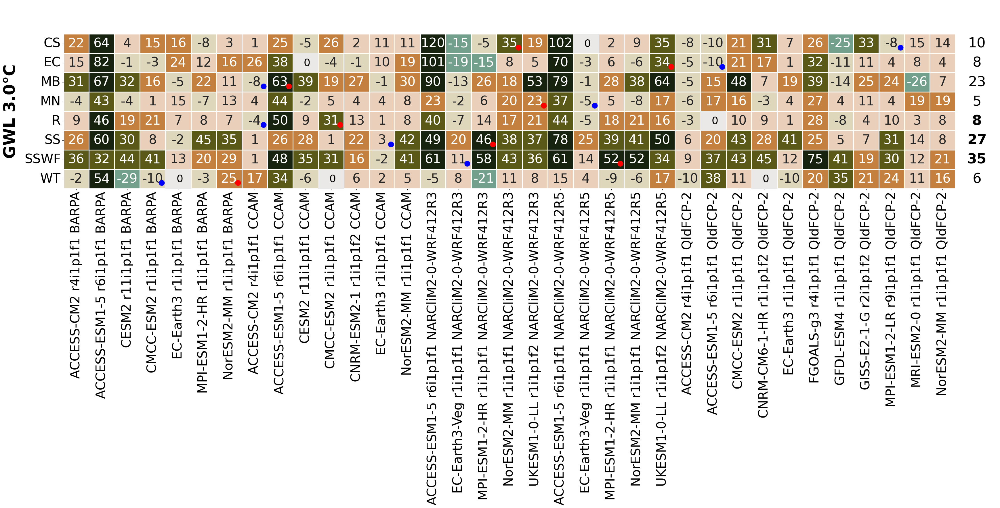

---> Plotting GWL1.5


<Figure size 640x480 with 0 Axes>

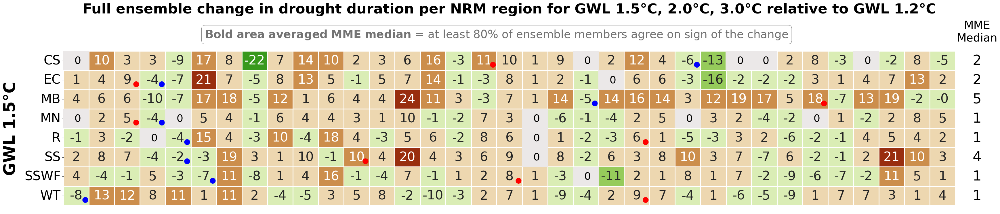

<Figure size 640x480 with 0 Axes>

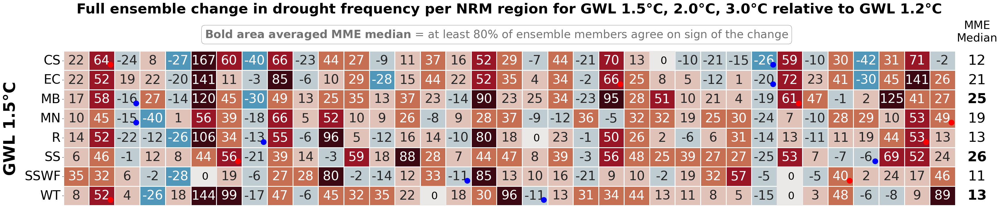

<Figure size 640x480 with 0 Axes>

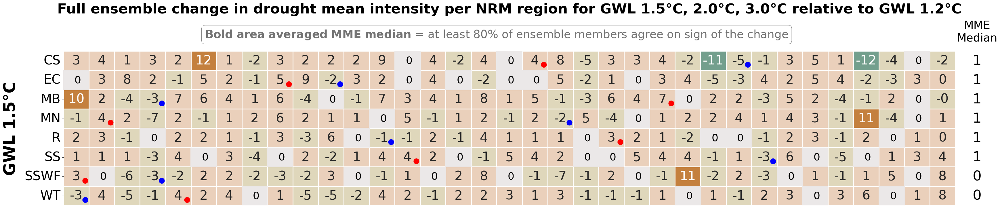

<Figure size 640x480 with 0 Axes>

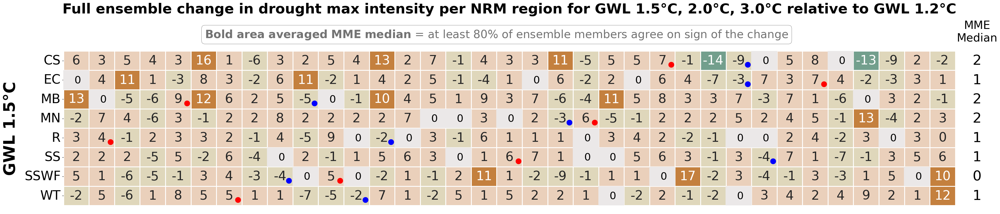

<Figure size 640x480 with 0 Axes>

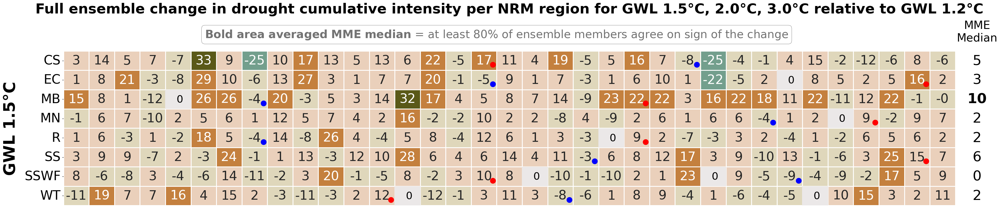

---> Plotting GWL2.0


<Figure size 640x480 with 0 Axes>

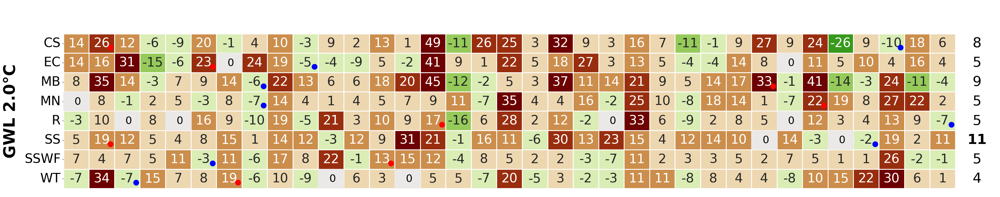

<Figure size 640x480 with 0 Axes>

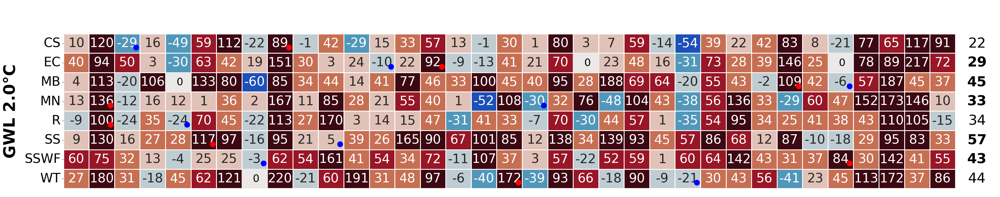

<Figure size 640x480 with 0 Axes>

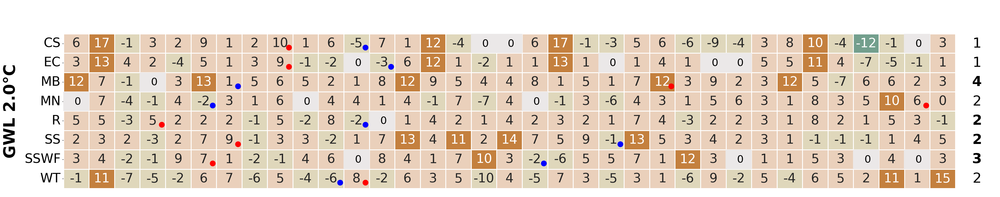

<Figure size 640x480 with 0 Axes>

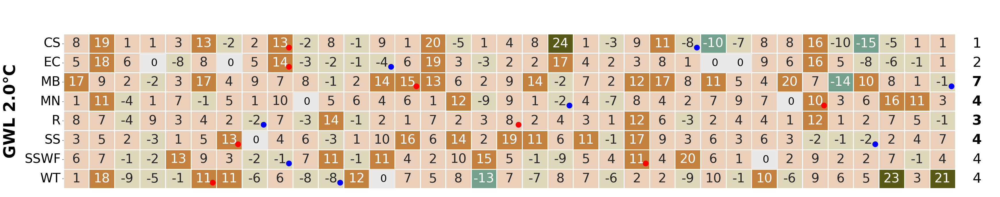

<Figure size 640x480 with 0 Axes>

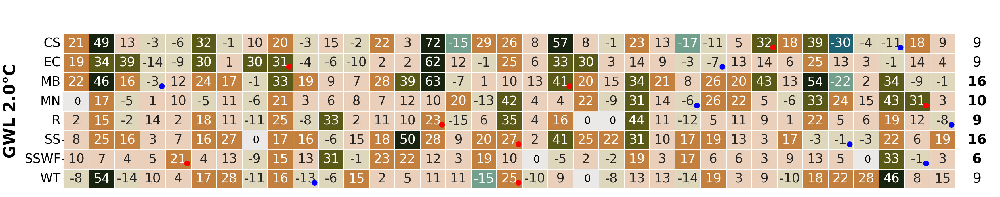

---> Plotting GWL3.0


<Figure size 640x480 with 0 Axes>

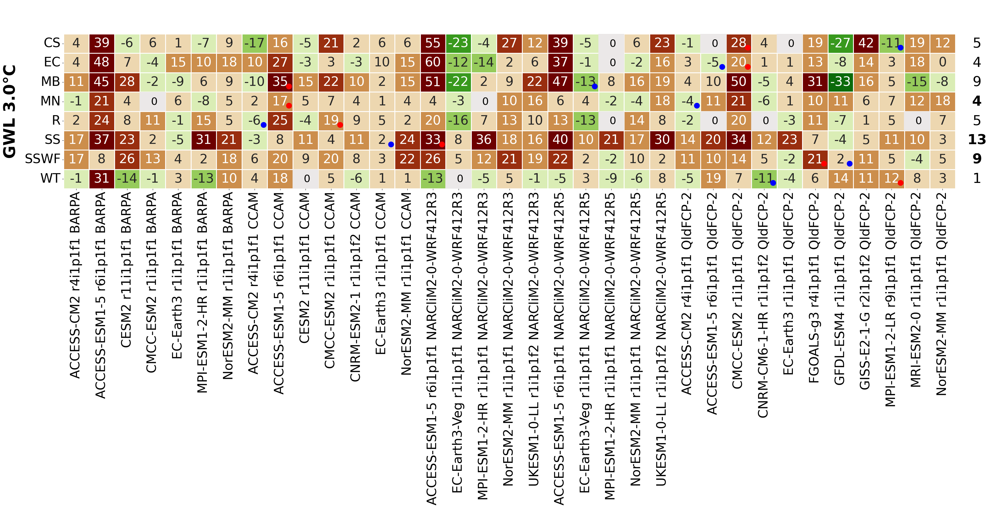

<Figure size 640x480 with 0 Axes>

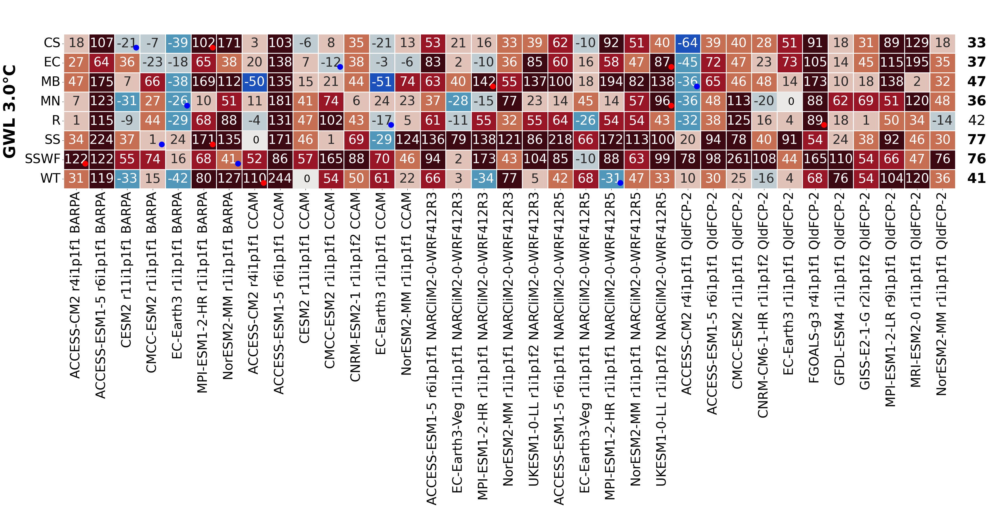

<Figure size 640x480 with 0 Axes>

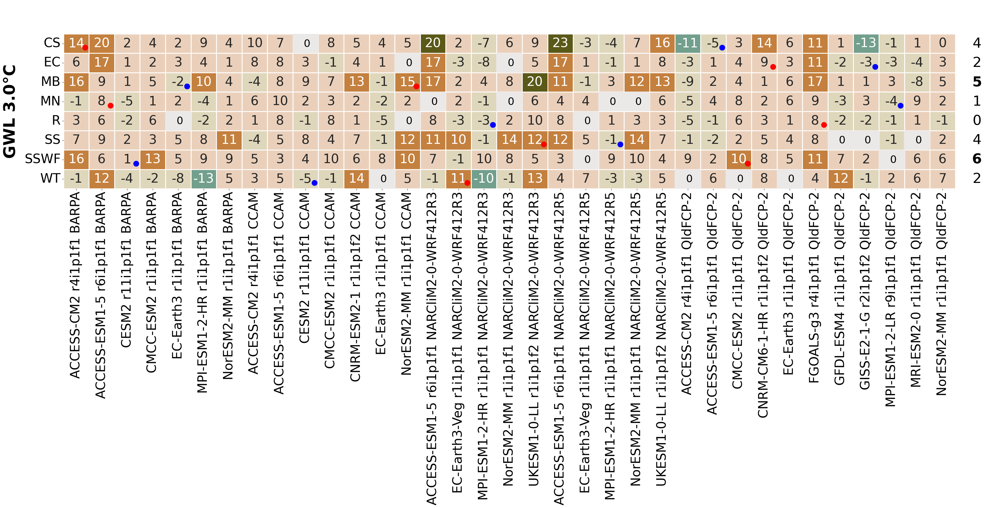

<Figure size 640x480 with 0 Axes>

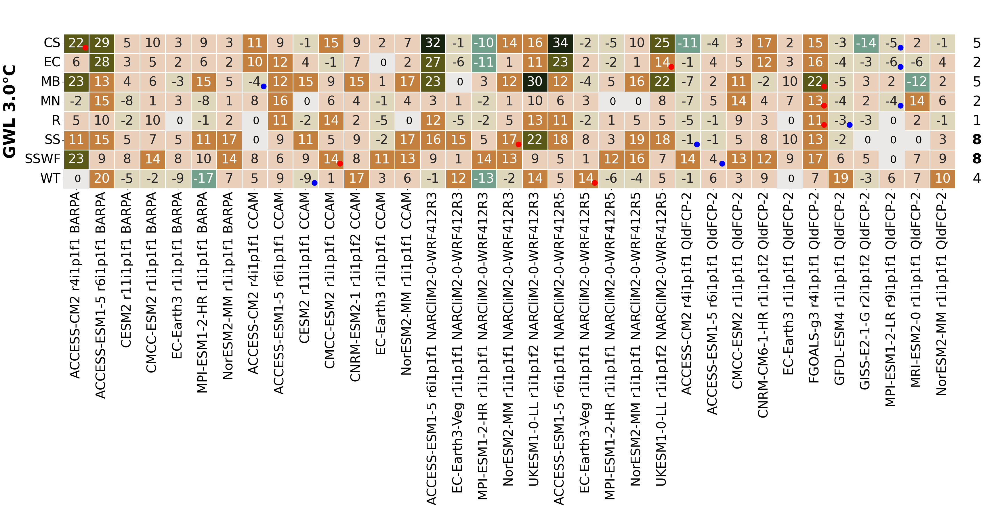

<Figure size 640x480 with 0 Axes>

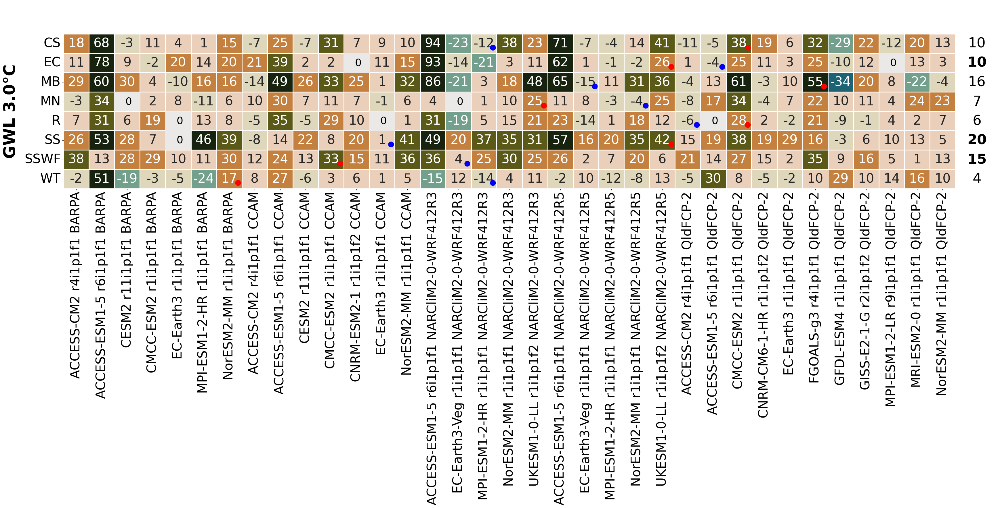

CPU times: user 26min 49s, sys: 4min 40s, total: 31min 29s
Wall time: 31min 32s


<Figure size 640x480 with 0 Axes>

In [39]:
%%time
import glob as glob
import cmocean
import seaborn as sns

mask_ds = xr.open_dataset("/g/data/ia39/aus-ref-clim-data-nci/shapefiles/masks/AGCD-05i/mask-fraction_agcd_v1-0-2_precip_weight_1960_2022.nc")
q_mask = np.ma.masked_where(mask_ds.fraction >= 0.8, mask_ds.fraction)

metric_dict = {}
for bc_method in ['QME', 'MRNBC']:
    ifd_grids = []
    ifd_grids.extend(sorted(glob.glob(f"/g/data/mn51/users/jb6465/data/spi_ifd_metrics/{SSP}/*{bc_method}*{BC_SOURCE}*.nc")))
    for GWL_level in [1.5, 2.0, 3.0]:
        duration_df_list = []
        frequency_df_list = []
        mean_intensity_df_list = []
        max_intensity_df_list = []
        cumulative_intensity_df_list = []
        #sort by RCM so heatmap clusters columns accordingly
        GWLx_files = sorted([file for file in ifd_grids if f"GWL{GWL_level}" in file], key=lambda x: x.split('_')[-4]) #[file for file in ifd_grids if f"GWL{GWL_level}" in file] 
        GWL12_files = sorted([file for file in ifd_grids if "GWL1.2" in file], key=lambda x: x.split('_')[-4]) #[file for file in ifd_grids if "GWL1.2" in file]
    
        for file_GWL12 in GWL12_files:
            file_GWLx = [file for file in GWLx_files if file_GWL12.split('_')[-7] in file and file_GWL12.split('_')[-5] and file_GWL12.split('_')[-4] in file and f'GWL{str(GWL_level)}' in file][0]
            # print(file_GWL12)
            # print(file_GWLx)
            
            ensemble_member_name = file_GWL12.split('_')[-7]+'_'+file_GWL12.split('_')[-5]+'_'+file_GWL12.split('_')[-4]
            ds_GWLx = xr.open_dataset(file_GWLx).where(q_mask.mask)
            ds_GWL12 = xr.open_dataset(file_GWL12).where(q_mask.mask)
            ensemble_member_name = ensemble_member_name.replace('UQ-DES', 'QldFCP-2')
            GWLx_change = (100*((ds_GWLx - ds_GWL12)/ds_GWL12)).rename({'SPI3': ensemble_member_name})      
            mask_frac = regions.mask_3D_frac_approx(GWLx_change)
            dims = ("lat", "lon",)
            
            duration_change_df = acs_regional_stats(ds=GWLx_change.sel(metric='duration'),var=ensemble_member_name, mask=mask_frac, dims = dims, how = ["mean"]).to_dataframe()
            duration_df_list.append(duration_change_df[duration_change_df.columns[-1]])

            frequency_change_df = acs_regional_stats(ds=GWLx_change.sel(metric='frequency'),var=ensemble_member_name, mask=mask_frac, dims = dims, how = ["mean"]).to_dataframe()
            frequency_df_list.append(frequency_change_df[frequency_change_df.columns[-1]])

            mean_intensity_change_df = acs_regional_stats(ds=GWLx_change.sel(metric='mean_intensity'),var=ensemble_member_name, mask=mask_frac, dims = dims, how = ["mean"]).to_dataframe()
            mean_intensity_df_list.append(mean_intensity_change_df[mean_intensity_change_df.columns[-1]])

            max_intensity_change_df = acs_regional_stats(ds=GWLx_change.sel(metric='max_intensity'),var=ensemble_member_name, mask=mask_frac, dims = dims, how = ["mean"]).to_dataframe()
            max_intensity_df_list.append(max_intensity_change_df[max_intensity_change_df.columns[-1]])

            cumulative_intensity_change_df = acs_regional_stats(ds=GWLx_change.sel(metric='cumulative_intensity'),var=ensemble_member_name, mask=mask_frac, dims = dims, how = ["mean"]).to_dataframe()
            cumulative_intensity_df_list.append(cumulative_intensity_change_df[cumulative_intensity_change_df.columns[-1]])
            
        duration_plot_df = pd.concat(duration_df_list, axis=1).rename_axis('NRM Region')
        frequency_plot_df = pd.concat(frequency_df_list, axis=1).rename_axis('NRM Region')
        mean_intensity_plot_df = pd.concat(mean_intensity_df_list, axis=1).rename_axis('NRM Region')
        max_intensity_plot_df = pd.concat(max_intensity_df_list, axis=1).rename_axis('NRM Region')
        cumulative_intensity_plot_df = pd.concat(cumulative_intensity_df_list, axis=1).rename_axis('NRM Region')
        
        print(f'---> Plotting GWL{str(GWL_level)}')
        plot_heatmap(duration_plot_df, GWL_level, 'duration', sns.color_palette('NEO_div_vegetation_a_r', 8), -40, 40, p10_p90_annotation_switch=True)
        plot_heatmap(frequency_plot_df, GWL_level, 'frequency', cmocean.cm.balance_r(np.linspace(0, 1, 8))[::-1], -100, 100, p10_p90_annotation_switch=True)
        plot_heatmap(mean_intensity_plot_df, GWL_level, 'mean_intensity', cmocean.cm.tarn(np.linspace(0, 1, 8))[::-1], -40, 40, p10_p90_annotation_switch=True)
        plot_heatmap(max_intensity_plot_df, GWL_level, 'max_intensity', cmocean.cm.tarn(np.linspace(0, 1, 8))[::-1], -40, 40, p10_p90_annotation_switch=True)
        plot_heatmap(cumulative_intensity_plot_df, GWL_level, 'cumulative_intensity', cmocean.cm.tarn(np.linspace(0, 1, 8))[::-1], -60, 60, p10_p90_annotation_switch=True)

### IFD scatter plots

#### dataframe generate

In [252]:
SSP

'ssp370'

In [8]:
import glob as glob
files = sorted(glob.glob(f"/g/data/mn51/users/jb6465/data/spi_ifd_metrics/{SSP}/*QME*{BC_SOURCE}*.nc")) + sorted(glob.glob(f"/g/data/mn51/users/jb6465/data/spi_ifd_metrics/{SSP}/*MRNBC*{BC_SOURCE}*.nc"))

In [9]:
len(files)/4/2 #4 gwls, 2 bc methods (35 ens members)

35.0

In [10]:
nrm_regions

,ClusterAb,geometry,SubClusNm,SubClusAb,ClusterNm,SupClusNm,SupClusAb
0,CS,"POLYGON ((147.957 -24.87855, 147.95711 -24.878...",Central Slopes,CS,Central Slopes,Eastern Australia,EA
1,EC,"MULTIPOLYGON (((153.53442 -28.17702, 153.53471...",East Coast (South),ECS,East Coast,Eastern Australia,EA
2,MB,"POLYGON ((145.74765 -32.21733, 145.75054 -32.2...",Murray Basin,MB,Murray Basin,Southern Australia,SA
3,MN,"POLYGON ((146.29742 -18.90381, 146.29992 -18.9...",Monsoonal North (East),MNE,Monsoonal North,Northern Australia,NA
4,R,"POLYGON ((114.14357 -22.538, 114.14296 -22.538...",Rangelands (North),RN,Rangelands,Rangelands,R
5,SS,"MULTIPOLYGON (((147.0437 -43.31381, 147.04111 ...",Southern Slopes (Vic/NSW East),SSVE,Southern Slopes,Southern Australia,SA
6,SSWF,"MULTIPOLYGON (((139.35429 -33.09761, 139.35429...",Southern and South Western Flatlands (West),SSWFW,Southern and South Western Flatlands,Southern Australia,SA
7,WT,"MULTIPOLYGON (((148.46219 -20.06725, 148.46352...",Wet Tropics,WT,Wet Tropics,Northern Australia,NA


In [11]:
name_column = "ClusterNm"
abbr_column = "ClusterAb"
shapefile_name = "nrm_regions"


nrm_regions =nrm_regions.to_crs(crs = "GDA2020")
nrm_regions.index = np.arange(0, len(nrm_regions))

regions= regionmask.from_geopandas(nrm_regions,
                                   names=name_column, 
                                   abbrevs=abbr_column, 
                                   name=shapefile_name,
                                   overlap=True) 
regions

<regionmask.Regions 'nrm_regions'>
overlap:  True

Regions:
0   CS                       Central Slopes
1   EC                           East Coast
2   MB                         Murray Basin
3   MN                      Monsoonal North
4    R                           Rangelands
5   SS                      Southern Slopes
6 SSWF Southern and South Western Flatlands
7   WT                          Wet Tropics

[8 regions]

In [ ]:
%%time
q_mask = np.ma.masked_greater(xr.open_dataset("/g/data/mn51/users/dh4185/agcd_v1-0-2_precip_weight_r005_daily_1960_2022fraction_ge1.nc").fraction,0.8)
plot_df_list = []

for file in files:
    GCM = file.split('_')[-7]
    RCM = 'BARPA-R' if file.split('_')[-4] == 'BOM' else 'CCAM-v2203-SN' if file.split('_')[-4] == 'CSIRO' else file.split('_')[-4]
    BC = file.split('_')[-1].split('-')[1]
    variant_id = file.split('_')[-5]
    GWL = file.split('_')[2].split('/')[-1]

    for metric in ['duration', 'frequency', 'mean_intensity', 'max_intensity', 'cumulative_intensity']:
        ensemble_member_name = f"{GCM}_{variant_id}_{RCM}_{BC}_{GWL}_{metric.replace('_', '-')}"
        ds_GWLx = xr.open_dataset(file).where(q_mask.mask).sel(metric=metric).rename({'SPI3': ensemble_member_name})
        mask_frac = regions.mask_3D_frac_approx(ds_GWLx)
        dims = ("lat", "lon",)
        nrm_regions_df = acs_regional_stats(ds=ds_GWLx, var=ensemble_member_name, mask=mask_frac, dims = dims, how = ["mean"]).to_dataframe()
        plot_df_list.append(nrm_regions_df.drop(columns=['names']))


ifd_df = pd.concat(plot_df_list, axis=1).drop(columns=['abbrevs', 'metric'])
plot_df = pd.DataFrame([
    {"NRM-region":nrm_regions_df['abbrevs'].values[nrm_region_idx], "GCM": col.split('_')[0]+'_'+col.split('_')[1], "RCM": col.split('_')[2], "BC": col.split('_')[3], "GWL": col.split('_')[4], "metric": col.split('_')[5], "value": ifd_df[col].iloc[nrm_region_idx]} 
    for col in ifd_df.columns 
    for nrm_region_idx, val in enumerate(ifd_df.values.astype('float32'))
])
plot_df.to_csv(f'/g/data/mn51/users/jb6465/data/spi_ifd_scatterplot_{SSP}.csv', index=False)

#### scatter plots

In [82]:
df = pd.read_csv(f'/g/data/mn51/users/jb6465/data/spi_ifd_scatterplot_{SSP}.csv').replace('UQ-DES', 'QldFCP-2')

In [83]:
df

,NRM-region,GCM,RCM,BC,GWL,metric,value
0,CS,ACCESS-CM2_r4i1p1f1,BARPA-R,QME,GWL1.2,duration,4.382912
1,EC,ACCESS-CM2_r4i1p1f1,BARPA-R,QME,GWL1.2,duration,4.794580
2,MB,ACCESS-CM2_r4i1p1f1,BARPA-R,QME,GWL1.2,duration,3.843031
3,MN,ACCESS-CM2_r4i1p1f1,BARPA-R,QME,GWL1.2,duration,3.880377
4,R,ACCESS-CM2_r4i1p1f1,BARPA-R,QME,GWL1.2,duration,3.975505
...,...,...,...,...,...,...,...
11195,MN,UKESM1-0-LL_r1i1p1f2,NARCliM2-0-WRF412R5,MRNBC,GWL3.0,cumulative-intensity,-6.512783
11196,R,UKESM1-0-LL_r1i1p1f2,NARCliM2-0-WRF412R5,MRNBC,GWL3.0,cumulative-intensity,-7.019684
11197,SS,UKESM1-0-LL_r1i1p1f2,NARCliM2-0-WRF412R5,MRNBC,GWL3.0,cumulative-intensity,-7.012202
11198,SSWF,UKESM1-0-LL_r1i1p1f2,NARCliM2-0-WRF412R5,MRNBC,GWL3.0,cumulative-intensity,-7.501271


In [84]:
df_wide = df.pivot_table(index=['NRM-region', 'GCM', 'RCM', 'BC', 'GWL'], columns='metric', values='value').reset_index()

In [85]:
df_wide

metric,NRM-region,GCM,RCM,BC,GWL,cumulative-intensity,duration,frequency,max-intensity,mean-intensity
0,CS,ACCESS-CM2_r4i1p1f1,BARPA-R,MRNBC,GWL1.2,-7.795249,4.446657,2.004218,-2.261070,-1.723102
1,CS,ACCESS-CM2_r4i1p1f1,BARPA-R,MRNBC,GWL1.5,-8.230891,4.481531,1.633752,-2.372998,-1.802762
2,CS,ACCESS-CM2_r4i1p1f1,BARPA-R,MRNBC,GWL2.0,-9.381403,5.236914,1.936010,-2.294640,-1.758566
3,CS,ACCESS-CM2_r4i1p1f1,BARPA-R,MRNBC,GWL3.0,-6.531945,3.909370,3.981904,-2.160514,-1.663580
4,CS,ACCESS-CM2_r4i1p1f1,BARPA-R,QME,GWL1.2,-7.643069,4.382912,2.000652,-2.295007,-1.717535
...,...,...,...,...,...,...,...,...,...,...
2235,WT,UKESM1-0-LL_r1i1p1f2,NARCliM2-0-WRF412R5,MRNBC,GWL3.0,-6.824613,4.294129,2.922677,-2.023024,-1.565012
2236,WT,UKESM1-0-LL_r1i1p1f2,NARCliM2-0-WRF412R5,QME,GWL1.2,-6.203175,3.929748,2.169546,-2.007635,-1.565415
2237,WT,UKESM1-0-LL_r1i1p1f2,NARCliM2-0-WRF412R5,QME,GWL1.5,-6.777381,4.179833,2.283450,-2.071380,-1.606444
2238,WT,UKESM1-0-LL_r1i1p1f2,NARCliM2-0-WRF412R5,QME,GWL2.0,-6.423685,4.092294,2.634624,-1.937848,-1.553648


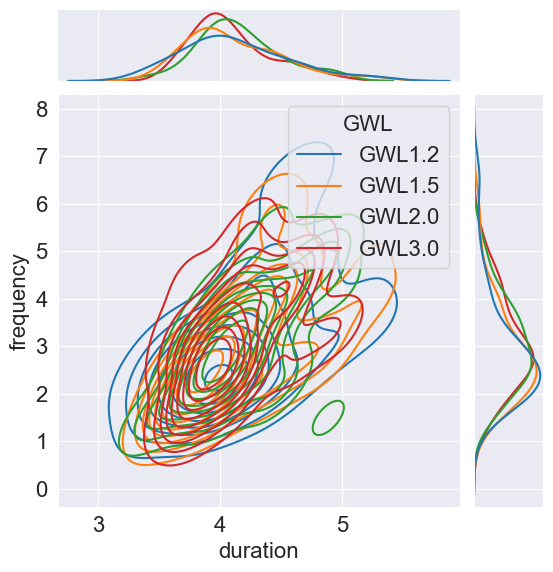

In [86]:
import seaborn as sns
sns.jointplot(data=df_wide[df_wide['NRM-region'] == 'WT'], x="duration", y="frequency", hue="GWL", kind='kde')

In [87]:
region_name_map = {
    'CS': r'$\mathbf{Central\ Slopes}$',
    'EC': r'$\mathbf{East\ Coast}$',
    'MB': r'$\mathbf{Murray\ Basin}$',
    'MN': r'$\mathbf{Monsoonal\ North}$',
    'R':  r'$\mathbf{Rangelands}$',
    'SS': r'$\mathbf{Southern\ Slopes}$',
    'SSWF': r'$\mathbf{Southern\ and\ South}$'+'\n'+r'$\mathbf{Western\ Flatlands}$',
    'WT': r'$\mathbf{Wet\ Tropics}$'
}

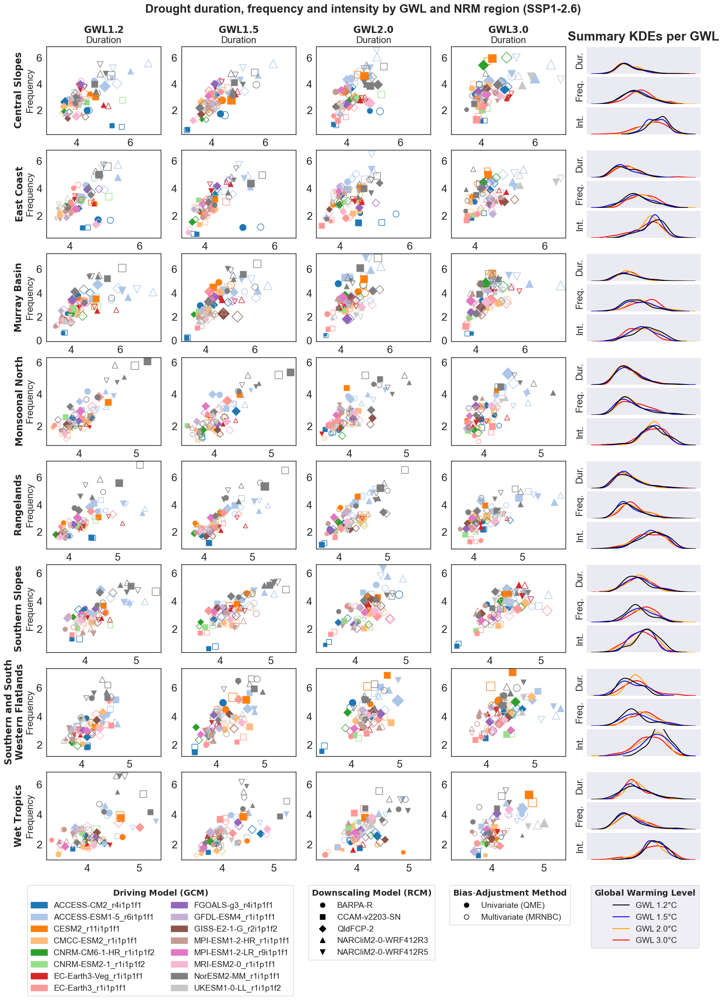

In [88]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
from matplotlib.gridspec import GridSpec

plt.rcParams.update({'font.size': 18})

fig = plt.figure(figsize=(20, 25))
outer_gs = GridSpec(8, 5, figure=fig, width_ratios=[1, 1, 1, 1, 1], wspace=0.18, hspace=0.18)
axes = [[None]*5 for _ in range(8)]

# 16 GCMs → Assign a distinct color per GCM
gcm_list = df['GCM'].unique()
gcm_colors = dict(zip(gcm_list, sns.color_palette("tab20", len(gcm_list))))

# 5 RCMs → Assign a unique marker per RCM
rcm_list = df['RCM'].unique()
rcm_markers = ['o', 's', 'D', '^', 'v']
rcm_shapes = dict(zip(rcm_list, rcm_markers))

# BC → outline or solid
bc_fillstyle = {
    'QME': 'full',
    'MRNBC': 'none'
}

# Create scatter plots with shared axes for first 4 cols in each row
for i, region in enumerate(list(df_wide['NRM-region'].unique())):
    for j, gwl in enumerate(['GWL1.2', 'GWL1.5', 'GWL2.0', 'GWL3.0']):
        if j == 0:
            ax = fig.add_subplot(outer_gs[i, j])
        elif j < 4:
            # Share x and y with the first col of the row
            ax = fig.add_subplot(outer_gs[i, j], sharex=axes[i][0], sharey=axes[i][0])
        else:
            ax = fig.add_subplot(outer_gs[i, j])

        axes[i][j] = ax
        subset = df_wide[(df_wide['NRM-region'] == region) & (df_wide['GWL'] == gwl)]

        for _, row in subset.iterrows():
            ax.plot(row['duration'], row['frequency'],
                    marker=rcm_shapes[row['RCM']],
                    markersize=(np.abs(row['max-intensity']) * 1.5) ** 2,
                    markerfacecolor=gcm_colors[row['GCM']] if row['BC'] == 'QME' else 'none',
                    markeredgecolor=gcm_colors[row['GCM']] if row['BC'] == 'MRNBC' else 'none',
                    markeredgewidth=1,
                    linestyle='None',
                    label='_nolegend_')
        ax.set_title(fr'$\mathbf{{{gwl}}}$' + '\n' + 'Duration' if i==0 else '', size=16)
        ax.set_ylabel(region_name_map.get(region, region) + '\n' + 'Frequency' if j == 0 else ' ', size=16)
        ax.yaxis.get_major_locator().set_params(integer=True)
        ax.set_xlabel('')
        ax.set_facecolor('white')

        # ax.axhline(np.percentile(subset_region[subset_region['BC'] == 'QME']['frequency'], 50), color='black', linewidth=0.5)
        # ax.axhline(np.percentile(subset_region[subset_region['BC'] == 'MRNBC']['frequency'], 50), color='blue', linewidth=0.5)
        
        # ax.axvline(np.percentile(subset_region[subset_region['BC'] == 'QME']['duration'], 50), color='black', linewidth=0.5)
        # ax.axvline(np.percentile(subset_region[subset_region['BC'] == 'MRNBC']['duration'], 50), color='blue', linewidth=0.5)


        for spine in ax.spines.values():
            spine.set_edgecolor('black')
            spine.set_linewidth(1)

# Plot the right-most column with KDE plots
dur_ylims=[(0,0.48)]
for i, region in enumerate(list(df_wide['NRM-region'].unique())):
    sns.set_style("darkgrid")
    subset_region = df_wide[df_wide['NRM-region'] == region]
    inner_gs = outer_gs[i, -1].subgridspec(3, 1, hspace=0.1, wspace=0)

    ax_dur = fig.add_subplot(inner_gs[0])
    ax_freq = fig.add_subplot(inner_gs[1])
    ax_maxi = fig.add_subplot(inner_gs[2])

    palette=["black", "blue", "orange", "red"]
    sns.kdeplot(data=subset_region, x='duration', hue='GWL', palette=palette, ax=ax_dur, legend=False)
    sns.kdeplot(data=subset_region, x='frequency', hue='GWL', palette=palette, ax=ax_freq, legend=False)
    sns.kdeplot(data=subset_region, x='max-intensity', hue='GWL', palette=palette, ax=ax_maxi, legend=False)
    
    # for color, gwl, yloc in zip(palette, ['GWL1.2', 'GWL1.5', 'GWL2.0', 'GWL3.0'], [0.9, 0.7, 0.5, 0.3]):
    #     mean_val = subset_region[subset_region['GWL'] == gwl]['duration'].median()
    #     ax_dur.axvline(mean_val, color=color, linestyle='--', linewidth=0.8)
    #     ax_dur.annotate(f'{mean_val:.2f}', xy=(0.9, yloc), xycoords=('axes fraction', 'axes fraction'), color=color, ha='center', va='top', fontsize=10)

    #     mean_val = subset_region[subset_region['GWL'] == gwl]['frequency'].median()
    #     ax_freq.axvline(mean_val, color=color, linestyle='--', linewidth=0.8)
    #     ax_freq.annotate(f'{mean_val:.2f}', xy=(0.9, yloc), xycoords=('axes fraction', 'axes fraction'), color=color, ha='center', va='top', fontsize=10)

    #     mean_val = subset_region[subset_region['GWL'] == gwl]['max-intensity'].median()
    #     ax_maxi.axvline(mean_val, color=color, linestyle='--', linewidth=0.8)
    #     ax_maxi.annotate(f'{mean_val:.2f}', xy=(0.9, yloc), xycoords=('axes fraction', 'axes fraction'), color=color, ha='center', va='top', fontsize=10)
    
    for ax in [ax_dur, ax_freq, ax_maxi]:
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_xlabel('')
        
    ax_dur.set_ylim(0,0.48)
    ax_freq.set_ylim(0,0.18)
    ax_maxi.set_ylim(0,1.02)

    ax_dur.set_ylabel('Dur.', size=16)
    ax_freq.set_ylabel('Freq.', size=16)
    ax_maxi.set_ylabel('Int.', size=16)
    
    ax_dur.set_title('Summary KDEs per GWL' if i==0 else '', weight='bold', pad=10)

# GCM legend
legend1 = fig.legend(handles=[mpatches.Patch(color=gcm_colors[gcm], label=gcm) for gcm in gcm_list],
                     title=r"$\bf{Driving\ Model\ (GCM)}$",
                     loc='upper center',
                     bbox_to_anchor=(0.26, 0.09),
                     ncol=2,
                     fontsize=14,
                     title_fontsize=14, facecolor='white')


# RCM legend
legend2 = fig.legend(handles=[mlines.Line2D([], [], color='black', marker=rcm_shapes[rcm], linestyle='None', markersize=8, label=rcm) for rcm in rcm_list],
                     title=r"$\bf{Downscaling\ Model\ (RCM)}$",
                     loc='upper center',
                     bbox_to_anchor=(0.51, 0.09),
                     ncol=1,
                     fontsize=14,
                     title_fontsize=14, facecolor='white')

# BC Method legend
legend3 = fig.legend(handles=[mlines.Line2D([], [], color='black', marker='o', linestyle='None', markersize=8, markerfacecolor='black', label='Univariate (QME)'),
                              mlines.Line2D([], [], color='black', marker='o', linestyle='None', markersize=8, markerfacecolor='none', label='Multivariate (MRNBC)')],
                     title=r"$\bf{Bias\text{-}Adjustment\ Method}$",
                     loc='upper center',
                     bbox_to_anchor=(0.674, 0.09),
                     ncol=1,
                     fontsize=14,
                     title_fontsize=14, facecolor='white')

legend4 = fig.legend(handles=[mlines.Line2D([], [], color='black', linestyle='-', label='GWL 1.2°C'),
                              mlines.Line2D([], [], color='blue', linestyle='-', label='GWL 1.5°C'),
                             mlines.Line2D([], [], color='orange', linestyle='-', label='GWL 2.0°C'),
                             mlines.Line2D([], [], color='red', linestyle='-', label='GWL 3.0°C')],
                     title=r"$\bf{Global\ Warming\ Level}$",
                     loc='upper center',
                     bbox_to_anchor=(0.834, 0.09),
                     ncol=1,
                     fontsize=14,
                     title_fontsize=14, facecolor='#EAEAF2')

fig.suptitle(f"Drought duration, frequency and intensity by GWL and NRM region ({SSP.upper()[0:4]+'-'+SSP[4]+'.'+SSP[5:]})", fontsize=20, y=0.92, fontweight='bold')
plt.show()


In [89]:
subset_region[subset_region['BC'] == 'QME']['frequency']

1964    2.625489
1965    2.042130
1966    2.120591
1967    2.375060
1972    1.718596
          ...   
2231    3.445436
2236    2.169546
2237    2.283450
2238    2.634624
2239    3.213237
Name: frequency, Length: 140, dtype: float64

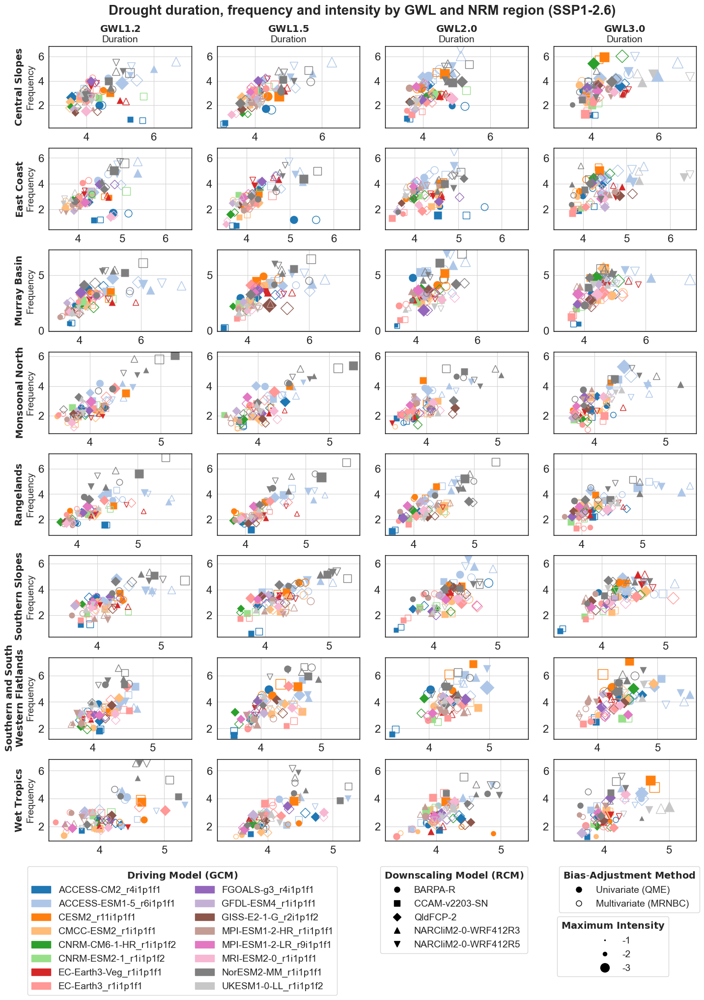

In [90]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import matplotlib.patches as mpatches
import matplotlib.lines as mlines
from matplotlib.gridspec import GridSpec

plt.rcParams.update({'font.size': 16})

fig = plt.figure(figsize=(17, 21))
outer_gs = GridSpec(8, 4, figure=fig, width_ratios=[1, 1, 1, 1], wspace=0.18, hspace=0.25)
axes = [[None]*5 for _ in range(8)]

# 16 GCMs → Assign a distinct color per GCM
gcm_list = df['GCM'].unique()
gcm_colors = dict(zip(gcm_list, sns.color_palette("tab20", len(gcm_list))))

# 5 RCMs → Assign a unique marker per RCM
rcm_list = df['RCM'].unique()
rcm_markers = ['o', 's', 'D', '^', 'v']
rcm_shapes = dict(zip(rcm_list, rcm_markers))

# BC → outline or solid
bc_fillstyle = {
    'QME': 'full',
    'MRNBC': 'none'
}

# Create scatter plots with shared axes for first 4 cols in each row
for i, region in enumerate(list(df_wide['NRM-region'].unique())):
    for j, gwl in enumerate(['GWL1.2', 'GWL1.5', 'GWL2.0', 'GWL3.0']):
        if j == 0:
            ax = fig.add_subplot(outer_gs[i, j])
        elif j < 4:
            # Share x and y with the first col of the row
            ax = fig.add_subplot(outer_gs[i, j], sharex=axes[i][0], sharey=axes[i][0])
        else:
            ax = fig.add_subplot(outer_gs[i, j])

        axes[i][j] = ax
        subset = df_wide[(df_wide['NRM-region'] == region) & (df_wide['GWL'] == gwl)]

        for _, row in subset.iterrows():
            ax.plot(row['duration'], row['frequency'],
                    marker=rcm_shapes[row['RCM']],
                    markersize=(np.abs(row['max-intensity']) * 1.5) ** 2,
                    markerfacecolor=gcm_colors[row['GCM']] if row['BC'] == 'QME' else 'none',
                    markeredgecolor=gcm_colors[row['GCM']] if row['BC'] == 'MRNBC' else 'none',
                    markeredgewidth=1,
                    linestyle='None',
                    label='_nolegend_')
            
        ax.grid(True, color='lightgrey', linewidth=0.8)
        # ax.axhline(np.percentile(subset['frequency'], 10), color='grey', linestyle='--', linewidth=0.5)
        # ax.axhline(np.percentile(subset['frequency'], 50), color='black', linestyle='--', linewidth=0.8)
        # ax.axhline(np.percentile(subset['frequency'], 90), color='grey', linestyle='--', linewidth=0.5)
        # ax.axvline(np.percentile(subset['duration'], 10), color='lightblue', linestyle='--', linewidth=0.5)
        # ax.axvline(np.percentile(subset['duration'], 50), color='blue', linestyle='--', linewidth=0.8)
        # ax.axvline(np.percentile(subset['duration'], 90), color='lightblue', linestyle='--', linewidth=0.5)

        ax.set_title(fr'$\mathbf{{{gwl}}}$' + '\n' + 'Duration' if i==0 else '', size=14)
        ax.set_ylabel(region_name_map.get(region, region) + '\n' + 'Frequency' if j == 0 else ' ', size=14)
        ax.yaxis.get_major_locator().set_params(integer=True)
        ax.set_xlabel('')
        ax.set_facecolor('white')
        for spine in ax.spines.values():
            spine.set_edgecolor('black')
            spine.set_linewidth(1)

# GCM legend
legend1 = fig.legend(handles=[mpatches.Patch(color=gcm_colors[gcm], label=gcm) for gcm in gcm_list],
                     title=r"$\bf{Driving\ Model\ (GCM)}$",
                     loc='upper center',
                     bbox_to_anchor=(0.285, 0.09),
                     ncol=2,
                     fontsize=14,
                     title_fontsize=14, facecolor='white')


# RCM legend
legend2 = fig.legend(handles=[mlines.Line2D([], [], color='black', marker=rcm_shapes[rcm], linestyle='None', markersize=8, label=rcm) for rcm in rcm_list],
                     title=r"$\bf{Downscaling\ Model\ (RCM)}$",
                     loc='upper center',
                     bbox_to_anchor=(0.61, 0.09),
                     ncol=1,
                     fontsize=14,
                     title_fontsize=14, facecolor='white')

# BC Method legend
legend3 = fig.legend(handles=[mlines.Line2D([], [], color='black', marker='o', linestyle='None', markersize=8, markerfacecolor='black', label='Univariate (QME)'),
                              mlines.Line2D([], [], color='black', marker='o', linestyle='None', markersize=8, markerfacecolor='none', label='Multivariate (MRNBC)')],
                     title=r"$\bf{Bias\text{-}Adjustment\ Method}$",
                     loc='upper center',
                     bbox_to_anchor=(0.82, 0.09),
                     ncol=1,
                     fontsize=14,
                     title_fontsize=14, facecolor='white')

# Max Int. legend
legend4 = fig.legend(handles=[mlines.Line2D([], [], color='black', marker='o', linestyle='None', markersize=(1*1.2)**2, markerfacecolor='black', label='-1'),
                              mlines.Line2D([], [], color='black', marker='o', linestyle='None', markersize=(2*1.2)**2, markerfacecolor='black', label='-2'),
                              mlines.Line2D([], [], color='black', marker='o', linestyle='None', markersize=(3*1.2)**2, markerfacecolor='black', label='-3')],
                     title=r"$\bf{Maximum\ Intensity}$",
                     loc='upper center',
                     bbox_to_anchor=(0.8005, 0.041),
                     ncol=1,
                     fontsize=14,
                     title_fontsize=14, facecolor='white')

fig.suptitle(f"Drought duration, frequency and intensity by GWL and NRM region ({SSP.upper()[0:4]+'-'+SSP[4]+'.'+SSP[5:]})", fontsize=20, y=0.92, fontweight='bold')
plt.show()


## Section 3.3 results

In [21]:
import glob as glob
qme_files = []
qme_files.extend(sorted(glob.glob(f"/g/data/ia39/ncra/drought_aridity/spi/downscaled_BC_5km/QME-{BC_SOURCE}/full_period/{SSP}/*AGCD-05i*.nc")))

mrnbc_files = []
mrnbc_files.extend(sorted(glob.glob(f"/g/data/ia39/ncra/drought_aridity/spi/downscaled_BC_5km/MRNBC-{BC_SOURCE}/full_period/{SSP}/*AGCD-05i*.nc")))

In [22]:
len(qme_files)

35

In [23]:
%%time
qme_pct_change = []
qme_pct_1995 = []
qme_pct_2080 = []
for file in qme_files:
    full_period = xr.open_dataset(file)
    spi_1995_2014 = full_period.sel(time=full_period['time'].dt.year.isin(range(1995, 2014+1)))
    spi_2080_2099 = full_period.sel(time=full_period['time'].dt.year.isin(range(2080, 2099+1)))

    pct_drought_1995_2014 = 100*((spi_1995_2014)<=-1).sum(dim='time')/len(spi_1995_2014.SPI3.time)
    pct_drought_2080_2099 = 100*((spi_2080_2099)<=-1).sum(dim='time')/len(spi_2080_2099.SPI3.time)

    qme_pct_change.append(((pct_drought_2080_2099-pct_drought_1995_2014)/pct_drought_1995_2014)*100)
    qme_pct_1995.append(pct_drought_1995_2014)
    qme_pct_2080.append(pct_drought_2080_2099)
    
qme_GWL_ens_list = ['_'.join((file.split('/')[-1]).split('_')[-7:-3]) for file in qme_files]
qme_MME_xr = xr.concat([file.assign_coords(MME=ensemble) for file, ensemble in zip(qme_pct_change, qme_GWL_ens_list)], dim='MME')
qme_plot_xr = qme_MME_xr.quantile([0.5], dim ='MME')

positive_agreement = (np.sign(qme_MME_xr)==1)
negative_agreement = (np.sign(qme_MME_xr)==-1)
agreement_threshold = int(0.8 * qme_MME_xr.SPI3.shape[0])

qme_stippling = (positive_agreement.sum(dim='MME')>agreement_threshold) + (negative_agreement.sum(dim='MME')>agreement_threshold)

/g/data/xp65/public/apps/med_conda/envs/analysis3-25.06/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1563: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,


CPU times: user 5min 33s, sys: 44.8 s, total: 6min 18s
Wall time: 6min 58s


In [24]:
%%time
mrnbc_pct_change = []
mrnbc_pct_1995 = []
mrnbc_pct_2080 = []
for file in mrnbc_files:
    full_period = xr.open_dataset(file)
    spi_1995_2014 = full_period.sel(time=full_period['time'].dt.year.isin(range(1995, 2014+1)))
    spi_2080_2099 = full_period.sel(time=full_period['time'].dt.year.isin(range(2080, 2099+1)))

    pct_drought_1995_2014 = 100*((spi_1995_2014)<=-1).sum(dim='time')/len(spi_1995_2014.SPI3.time)
    pct_drought_2080_2099 = 100*((spi_2080_2099)<=-1).sum(dim='time')/len(spi_2080_2099.SPI3.time)

    mrnbc_pct_change.append(((pct_drought_2080_2099-pct_drought_1995_2014)/pct_drought_1995_2014)*100)
    mrnbc_pct_1995.append(pct_drought_1995_2014)
    mrnbc_pct_2080.append(pct_drought_2080_2099)
    
mrnbc_GWL_ens_list = ['_'.join((file.split('/')[-1]).split('_')[-7:-3]) for file in mrnbc_files]
mrnbc_MME_xr = xr.concat([file.assign_coords(MME=ensemble) for file, ensemble in zip(mrnbc_pct_change, mrnbc_GWL_ens_list)], dim='MME')
mrnbc_plot_xr = mrnbc_MME_xr.quantile([0.5], dim ='MME')

positive_agreement = (np.sign(mrnbc_MME_xr)==1)
negative_agreement = (np.sign(mrnbc_MME_xr)==-1)
agreement_threshold = int(0.8 * mrnbc_MME_xr.SPI3.shape[0])

mrnbc_stippling = (positive_agreement.sum(dim='MME')>agreement_threshold) + (negative_agreement.sum(dim='MME')>agreement_threshold)

/g/data/xp65/public/apps/med_conda/envs/analysis3-25.06/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1563: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
/g/data/xp65/public/apps/med_conda/envs/analysis3-25.06/lib/python3.11/site-packages/numpy/lib/function_base.py:4658: RuntimeWarning: invalid value encountered in subtract
  subtract(b, diff_b_a * (1 - t), out=lerp_interpolation, where=t >= 0.5,
/g/data/xp65/public/apps/med_conda/envs/analysis3-25.06/lib/python3.11/site-packages/numpy/lib/function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)


CPU times: user 5min 47s, sys: 44.3 s, total: 6min 31s
Wall time: 7min 16s


In [25]:
q_mask = np.ma.masked_greater(xr.open_dataset("/g/data/mn51/users/dh4185/agcd_v1-0-2_precip_weight_r005_daily_1960_2022fraction_ge1.nc").fraction,0.8)

CPU times: user 33.1 s, sys: 134 ms, total: 33.2 s
Wall time: 33.3 s


(<Figure size 670x400 with 4 Axes>,
 array([<GeoAxes: >, <GeoAxes: >], dtype=object))

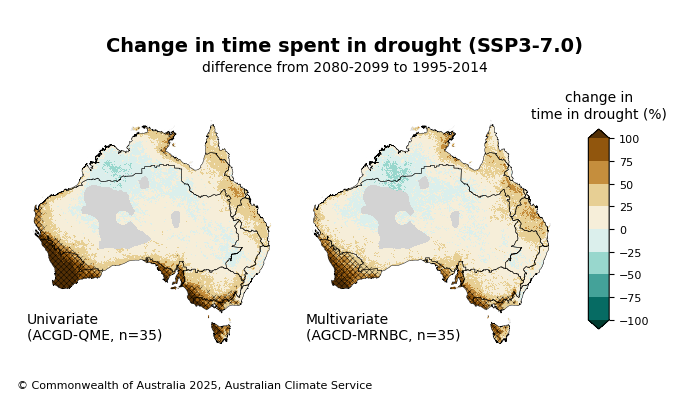

In [26]:
%%time
ds_mrnbc = mrnbc_plot_xr.sel(quantile = 0.5)
ds_qme = qme_plot_xr.sel(quantile = 0.5)

coarsen_factor = 2 #for fuzzy edge bug from https://github.com/AusClimateService/plotting_maps/blob/main/reports/fire_climate_classes_projections.ipynb

plot_acs_hazard_2pp(ds1=ds_qme['SPI3'],
                    ds2=ds_mrnbc['SPI3'],
                    stippling1=qme_stippling.SPI3.where(q_mask.mask).coarsen(lat=coarsen_factor, boundary="pad").mean().coarsen(lon=coarsen_factor, boundary="pad").mean()>0.3,
                    stippling2=mrnbc_stippling.SPI3.where(q_mask.mask).coarsen(lat=coarsen_factor, boundary="pad").mean().coarsen(lon=coarsen_factor, boundary="pad").mean()>0.3,
                    title = f"Change in time spent in drought ({SSP.upper()[0:4]+'-'+SSP[4]+'.'+SSP[5:]})",
                    date_range="difference from 2080-2099 to 1995-2014",
                    subplot_titles=["Univariate\n(ACGD-QME, n=35)", "Multivariate\n(AGCD-MRNBC, n=35)"] if BC_SOURCE=='AGCDv1' else ["Univariate\n(BARRA-QME, n=35)", "Multivariate\n(BARRA-MRNBC, n=35)"],
                    cmap = cmap_dict["pr_anom"].reversed(),
                    agcd_mask=True,
                    regions = nrm_regions, #regions_dict['ncra_regions'],
                    ticks = np.arange(-100, 101, 25),
                    cbar_label = "change in\ntime in drought (%)",
                    watermark="",
                    orientation="horizontal",
                    issued_date="",
                   )

In [27]:
barpa_mrnbc = mrnbc_MME_xr.sel(MME=[key for key in mrnbc_MME_xr.MME.values if 'BOM' in key])
ccam_mrnbc = mrnbc_MME_xr.sel(MME=[key for key in mrnbc_MME_xr.MME.values if 'CSIRO' in key])
qld_mrnbc = mrnbc_MME_xr.sel(MME=[key for key in mrnbc_MME_xr.MME.values if 'UQ-DES' in key])
nsw_mrnbc = mrnbc_MME_xr.sel(MME=[key for key in mrnbc_MME_xr.MME.values if 'NARCliM2' in key])

In [28]:
barpa_qme = qme_MME_xr.sel(MME=[key for key in qme_MME_xr.MME.values if 'BOM' in key])
ccam_qme = qme_MME_xr.sel(MME=[key for key in qme_MME_xr.MME.values if 'CSIRO' in key])
qld_qme = qme_MME_xr.sel(MME=[key for key in qme_MME_xr.MME.values if 'UQ-DES' in key])
nsw_qme = qme_MME_xr.sel(MME=[key for key in qme_MME_xr.MME.values if 'NARCliM2' in key])

In [29]:
%%time
ds_list = [target_xr.quantile([0.5], dim ='MME') for target_xr in [qme_MME_xr, barpa_qme, ccam_qme, qld_qme, nsw_qme, mrnbc_MME_xr, barpa_mrnbc, ccam_mrnbc, qld_mrnbc, nsw_mrnbc]]

/g/data/xp65/public/apps/med_conda/envs/analysis3-25.06/lib/python3.11/site-packages/numpy/lib/nanfunctions.py:1563: RuntimeWarning: All-NaN slice encountered
  return function_base._ureduce(a,
/g/data/xp65/public/apps/med_conda/envs/analysis3-25.06/lib/python3.11/site-packages/numpy/lib/function_base.py:4658: RuntimeWarning: invalid value encountered in subtract
  subtract(b, diff_b_a * (1 - t), out=lerp_interpolation, where=t >= 0.5,
/g/data/xp65/public/apps/med_conda/envs/analysis3-25.06/lib/python3.11/site-packages/numpy/lib/function_base.py:4655: RuntimeWarning: invalid value encountered in subtract
  diff_b_a = subtract(b, a)
/g/data/xp65/public/apps/med_conda/envs/analysis3-25.06/lib/python3.11/site-packages/numpy/lib/function_base.py:4657: RuntimeWarning: invalid value encountered in multiply
  lerp_interpolation = asanyarray(add(a, diff_b_a * t, out=out))


CPU times: user 4min 5s, sys: 168 ms, total: 4min 5s
Wall time: 4min 5s


In [30]:
stippling_list = []
for target_xr in [qme_MME_xr, barpa_qme, ccam_qme, qld_qme, nsw_qme, mrnbc_MME_xr, barpa_mrnbc, ccam_mrnbc, qld_mrnbc, nsw_mrnbc]:
    positive_agreement = (np.sign(target_xr)==1)
    negative_agreement = (np.sign(target_xr)==-1)
    agreement_threshold = int(0.8 * target_xr.SPI3.shape[0])
    
    stippling = (positive_agreement.sum(dim='MME')>agreement_threshold) + (negative_agreement.sum(dim='MME')>agreement_threshold)
    stippling_list.append(stippling.SPI3.where(q_mask.mask).coarsen(lat=coarsen_factor, boundary="pad").mean().coarsen(lon=coarsen_factor, boundary="pad").mean()>0.3)

CPU times: user 39 s, sys: 73.5 ms, total: 39.1 s
Wall time: 39.1 s


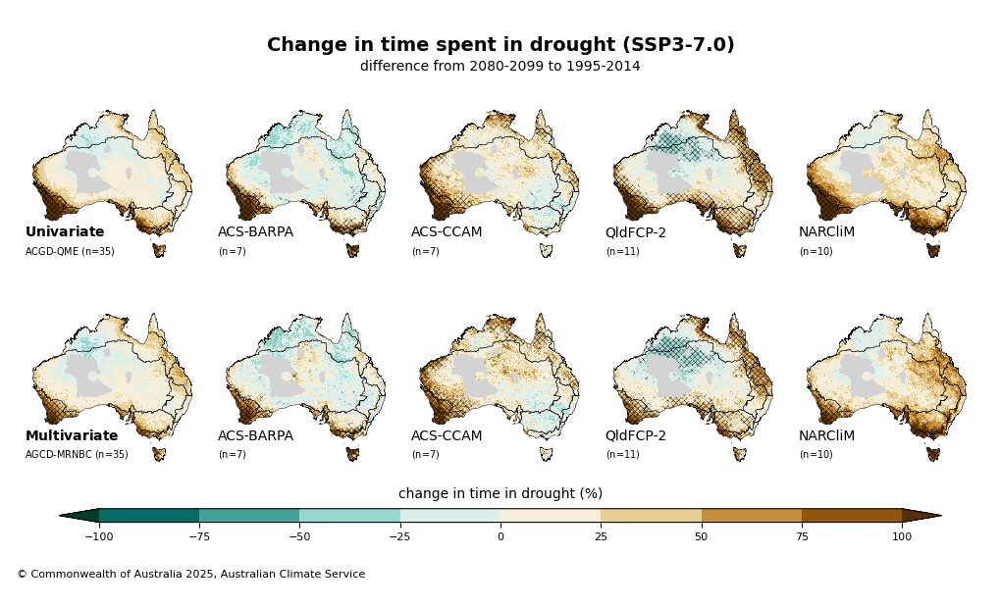

In [31]:
%%time
plot_acs_hazard_multi(ds_list=[ds['SPI3'] for ds in ds_list],
                    ncols=5, 
                    nrows=2,
                    figsize=(10,6),
                    title = f"Change in time spent in drought ({SSP.upper()[0:4]+'-'+SSP[4]+'.'+SSP[5:]})",
                    date_range = "difference from 2080-2099 to 1995-2014",
                    stippling_list=stippling_list,
                    cmap = cmap_dict["pr_anom"].reversed(),
                    agcd_mask=True,
                    regions = nrm_regions, #regions_dict['ncra_regions'],
                    ticks = np.arange(-100, 101, 25),
                    cbar_label = "change in time in drought (%)",
                    subplot_titles=[r'$\bf{Univariate}$'+'\n'+r'$\text{}_{\text{ACGD-QME \(n=35)}}$', 'ACS-BARPA\n'+ r'$\text{}_{\text{(n=7)}}$', 'ACS-CCAM\n'+ r'$\text{}_{\text{(n=7)}}$', 'QldFCP-2\n'+ r'$\text{}_{\text{(n=11)}}$', 'NARCliM\n'+ r'$\text{}_{\text{(n=10)}}$',\
                                    r'$\bf{Multivariate}$'+'\n'+r'$\text{}_{\text{AGCD-MRNBC \(n=35)}}$', 'ACS-BARPA\n'+ r'$\text{}_{\text{(n=7)}}$', 'ACS-CCAM\n'+ r'$\text{}_{\text{(n=7)}}$', 'QldFCP-2\n'+ r'$\text{}_{\text{(n=11)}}$', 'NARCliM\n'+ r'$\text{}_{\text{(n=10)}}$'] if BC_SOURCE=='AGCDv1' else [r'$\bf{Univariate}$'+'\n'+r'$\text{}_{\text{BARRA-QME \(n=35)}}$', 'ACS-BARPA\n'+ r'$\text{}_{\text{(n=7)}}$', 'ACS-CCAM\n'+ r'$\text{}_{\text{(n=7)}}$', 'QldFCP-2\n'+ r'$\text{}_{\text{(n=11)}}$', 'NARCliM\n'+ r'$\text{}_{\text{(n=10)}}$', r'$\bf{Multivariate}$'+'\n'+r'$\text{}_{\text{BARRA-MRNBC \(n=35)}}$', 'ACS-BARPA\n'+ r'$\text{}_{\text{(n=7)}}$', 'ACS-CCAM\n'+ r'$\text{}_{\text{(n=7)}}$', 'QldFCP-2\n'+ r'$\text{}_{\text{(n=11)}}$', 'NARCliM\n'+ r'$\text{}_{\text{(n=10)}}$'],
                    watermark="",
                    cbar_location="bottom",
                    issued_date="",
);